In [1]:
#### Rama projektowa - Opisywanie obrazów z wykorzystaniem głębokiego uczenia
#### autorzy: Anna Konieczna, Mateusz Ostrowski

### Rama projektowa
Tutorial: https://towardsdatascience.com/image-captioning-with-keras-teaching-computers-to-describe-pictures-c88a46a311b8 <br>
Zbiór danych: <br>
### Model atencji przyłączeniowej
Tutorial: https://www.analyticsvidhya.com/blog/2020/11/attention-mechanism-for-caption-generation/ oraz https://medium.com/swlh/image-captioning-using-attention-mechanism-f3d7fc96eb0e
#### Opis:  <br>


In [2]:
#### Config
config = { "images_path": "../Flickr8k_Dataset/",
           "train_images_path": "../Flickr8k_text/Flickr_8k.trainImages.txt", # file conatains the names of images to be used in train data
           "test_images_path": "../Flickr8k_text/Flickr_8k.testImages.txt",
           "train_path": "../Flickr8k_text/Flickr_8k.trainImages.txt", 
           "token_path": "../Flickr8k_text/Flickr8k.token.txt",
           "word_embedings_path": "../glove/glove.6B.200d.txt",
           "embedings_dim": 200, # Polish - 100
           "train_model": False, # True if you intend to train the model
           "encode_images": False,
           "pretrained_model_path": "",
           "encoded_images_test": "../Pickle/encoded_test_images.pkl",
           "encoded_images_train": "../Pickle/encoded_train_images.pkl",
           "report_path": "",
           "preprocessed_descriptions_save_path": "descriptions.txt",
           "use_lemma": False,
           "spacy_lemma_model": "pl_spacy_model",
           "lstm_model_save_dir": "../model_weights/",
           "lstm_model_save_path": "../model_weights/model_30.h5"}

In [3]:
import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector,\
                         Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.optimizers import Adam, RMSprop
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
#from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras import Input, layers
from keras import optimizers
#from keras.applications.inception_v3 import preprocess_input
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from nltk.translate.meteor_score import meteor_score
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu

#metric imports
from numpy import mean
import warnings; warnings.simplefilter('ignore')
from IPython.display import clear_output
import nltk
nltk.download('wordnet')

#additionall imports
import pickle
from collections import Counter
from pandas.core.common import flatten

import sys, time, warnings
warnings.filterwarnings("ignore")
import re

import keras
import tensorflow as tf
from tqdm import tqdm

from keras.utils import plot_model

from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import VGG16, preprocess_input

from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

/opt/conda/lib/python3.8/site-packages/scipy/__init__.py:138: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.16.0)
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion} is required for this version of "
[nltk_data] Downloading package wordnet to /home/jovyan/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [4]:
# Load the description set

def load_doc(filename):
	file = open(filename, 'r')
	text = file.read()
	file.close()
	return text

filename = config["token_path"]
# załaduj opisy
doc = load_doc(filename)
print(doc[:300])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the s


In [5]:
# Load the descriptions to dict structure

def load_descriptions(doc):
	mapping = dict()
	for line in doc.split('\n'):
		tokens = line.split()
		if len(line) < 2:
			continue
		# take the first token as the image id, the rest as the description
		image_id, image_desc = tokens[0], tokens[1:]
		# extract filename from image id
		image_id = image_id.split('.')[0]
		# convert description tokens back to string
		image_desc = ' '.join(image_desc)
		# create the list if needed
		if image_id not in mapping:
			mapping[image_id] = list()
		# store description
		mapping[image_id].append(image_desc)
	return mapping

# parse descriptions
descriptions = load_descriptions(doc)
print('Loaded: %d ' % len(descriptions))

Loaded: 8092 


In [6]:
if config["use_lemma"]:
    import spacy
    nlp = spacy.load('pl_spacy_model')

def clean_descriptions(descriptions):
  # prepare translation table for removing punctuation
  table = str.maketrans('', '', string.punctuation)
  for key, desc_list in descriptions.items():
    for i in range(len(desc_list)):
      desc = desc_list[i]
      if config["use_lemma"]:
          doc = nlp(desc)
      # tokenize
      desc = desc.split()
      # convert to lower case
      desc = [word.lower() for word in desc]
# Lematyzacja
#### spacy model from here: http://zil.ipipan.waw.pl/SpacyPL?action=AttachFile&do=view&target=pl_spacy_model-0.1.0.tar.gz
#### spacy dokumentacja - https://spacy.io/usage
      if config["use_lemma"]:
          desc = [word.lemma_ for word in doc]
      # remove punctuation from each token
      desc = [w.translate(table) for w in desc]
      # remove tokens with numbers in them
      desc = [word for word in desc if word.isalpha()]
      # store as string
      desc_list[i] =  ' '.join(desc)

# clean descriptions
clean_descriptions(descriptions)

In [7]:
# convert the loaded descriptions into a vocabulary of words
def to_vocabulary(descriptions):
	# build a list of all description strings
	all_desc = set()
	for key in descriptions.keys():
		[all_desc.update(d.split()) for d in descriptions[key]]
	return all_desc

# summarize vocabulary
vocabulary = to_vocabulary(descriptions)
print('Original Vocabulary Size: %d' % len(vocabulary))

Original Vocabulary Size: 8775


In [8]:
# save descriptions to file, one per line
def save_descriptions(descriptions, filename):
	lines = list()
	for key, desc_list in descriptions.items():
		for desc in desc_list:
			lines.append(key + ' ' + desc)
	data = '\n'.join(lines)
	file = open(filename, 'w')
	file.write(data)
	file.close()

save_descriptions(descriptions, config["preprocessed_descriptions_save_path"])

In [9]:
# load a pre-defined list of photo identifiers
def load_set(filename):
	doc = load_doc(filename)
	dataset = list()
	# process line by line
	for line in doc.split('\n'):
		# skip empty lines
		if len(line) < 1:
			continue
		# get the image identifier
		identifier = line.split('.')[0]
		dataset.append(identifier)
	return set(dataset)

# load training dataset (6K)
filename = config["train_path"]
train = load_set(filename)
print('Train Dataset: %d' % len(train))

#load test dataset (1K)
filename = config["test_images_path"]
test = load_set(filename)
print('Test Dataset: %d' % len(test))

Train Dataset: 6000
Test Dataset: 1000


In [10]:
# Below path contains all the images
images = config["images_path"]
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')

In [11]:
# Read the train image names in a set
train_images = set(open(config["train_images_path"], 'r').read().strip().split('\n'))

# Create a list of all the training images with their full path names
train_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in train_images: # Check if the image belongs to training set
        train_img.append(i) # Add it to the list of train images

In [12]:
# Below file conatains the names of images to be used in test data
test_images_file = config["test_images_path"]
# Read the validation image names in a set# Read the test image names in a set
test_images = set(open(test_images_file, 'r').read().strip().split('\n'))

# Create a list of all the test images with their full path names
test_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in test_images: # Check if the image belongs to test set
        test_img.append(i) # Add it to the list of test images
print('Test images: %d' % len(test_img))

Test images: 1000


In [13]:
# load clean descriptions into memory
def load_clean_descriptions(filename, dataset):
	# load document
	doc = load_doc(filename)
	descriptions = dict()
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		# split id from description
		image_id, image_desc = tokens[0], tokens[1:]
		# skip images not in the set
		if image_id in dataset:
			# create list
			if image_id not in descriptions:
				descriptions[image_id] = list()
			# wrap description in tokens
			desc = 'startseq ' + ' '.join(image_desc) + ' endseq'
			# store
			descriptions[image_id].append(desc)
	return descriptions

# descriptions
train_descriptions = load_clean_descriptions(config["preprocessed_descriptions_save_path"], train)
test_descriptions = load_clean_descriptions(config["preprocessed_descriptions_save_path"], test)
print('Descriptions: train=%d' % len(train_descriptions))

Descriptions: train=6000


In [15]:
def load_image(images_path):
   img = tf.io.read_file(images_path)
   img = tf.image.decode_jpeg(img, channels=3)
   img = tf.image.resize(img, (299, 299))
   img = tf.keras.applications.inception_v3.preprocess_input(img)
   return img, images_path

image_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')
new_input = image_model.input
hidden_layer = image_model.layers[-1].output
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

image_features_extract_model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [17]:
#encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(train_img)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)

In [18]:

#execute only once to encode npm features into files

"""
%%time
for img, path in tqdm(image_dataset):
 batch_features = image_features_extract_model(img)
 batch_features = tf.reshape(batch_features,
                             (batch_features.shape[0], -1, batch_features.shape[3]))

 for bf, p in zip(batch_features, path):
   path_of_feature = p.numpy().decode("utf-8")
   np.save(path_of_feature, bf.numpy())    
"""

'\n%%time\nfor img, path in tqdm(image_dataset):\n batch_features = image_features_extract_model(img)\n batch_features = tf.reshape(batch_features,\n                             (batch_features.shape[0], -1, batch_features.shape[3]))\n\n for bf, p in zip(batch_features, path):\n   path_of_feature = p.numpy().decode("utf-8")\n   np.save(path_of_feature, bf.numpy())    \n'

In [21]:
# Create a list of all the training captions
all_train_captions = []
img_name_train = []

for key, val in train_descriptions.items():
    for cap in val:
        all_train_captions.append(cap)
        img_name_train.append(config["images_path"] + key + ".jpg")

all_train_captions, img_name_train = shuffle(all_train_captions, img_name_train, random_state=1)

num_of_baths = len(img_name_train) // 64
num = num_of_baths * 64

all_train_captions = all_train_captions[:num]
img_name_train = img_name_train[:num]

print(len(all_train_captions))

29952


In [22]:
# Create a list of all the testing captions
all_test_captions = []
for key, val in test_descriptions.items():
    for cap in val:
        all_test_captions.append(cap)
len(all_test_captions)

5000

In [23]:
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                 oov_token="<unk>",
                                                 filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

tokenizer.fit_on_texts(all_train_captions)
train_seqs = tokenizer.texts_to_sequences(all_train_captions)
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

train_seqs = tokenizer.texts_to_sequences(all_train_captions)
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [24]:
all_train_captions[:3]

['startseq a large brown dog sniffs a small white dog s behind endseq',
 'startseq man rides bike while grimacing endseq',
 'startseq a black and white dog is running through a grassy area endseq']

In [25]:
train_seqs[:3]

[[3, 2, 59, 26, 10, 1407, 2, 53, 15, 10, 158, 98, 4],
 [3, 12, 133, 79, 36, 4477, 4],
 [3, 2, 16, 9, 15, 10, 8, 33, 34, 2, 126, 152, 4]]

In [26]:
def calc_max_length(tensor):
   return max(len(t) for t in tensor)
max_length = calc_max_length(train_seqs)

def calc_min_length(tensor):
   return min(len(t) for t in tensor)
min_length = calc_min_length(train_seqs)

print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 37 : 4


In [28]:
cap_train = cap_vector

In [29]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1
num_steps = len(img_name_train) // BATCH_SIZE
features_shape = 512
attention_features_shape = 64

In [30]:
class Encoder(tf.keras.Model):
   # This encoder passes the features through a Fully connected layer
   def __init__(self, embedding_dim):
       super(Encoder, self).__init__()
       # shape after fc == (batch_size, 49, embedding_dim)
       self.fc = tf.keras.layers.Dense(embedding_dim)
       self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

   def call(self, x):
       #x= self.dropout(x)
       x = self.fc(x)
       x = tf.nn.relu(x)
       return x 

In [31]:
'''The encoder output(i.e. 'features'), hidden state(initialized to 0)(i.e. 'hidden') and
the decoder input (which is the start token)(i.e. 'x') is passed to the decoder.'''

class Rnn_Local_Decoder(tf.keras.Model):
 def __init__(self, embedding_dim, units, vocab_size):
   super(Rnn_Local_Decoder, self).__init__()
   self.units = units
   self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
   self.lstm = tf.keras.layers.LSTM(self.units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_initializer='glorot_uniform')
  
   self.fc1 = tf.keras.layers.Dense(self.units)

   self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)
   self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

   self.fc2 = tf.keras.layers.Dense(vocab_size)

   # Implementing Attention Mechanism
   self.Uattn = tf.keras.layers.Dense(units)
   self.Wattn = tf.keras.layers.Dense(units)
   self.Vattn = tf.keras.layers.Dense(1)

 def call(self, x, features, hidden):
   # features shape ==> (64,49,256) ==> Output from ENCODER
   # hidden shape == (batch_size, hidden_size) ==>(64,512)
   # hidden_with_time_axis shape == (batch_size, 1, hidden_size) ==> (64,1,512)

   hidden_with_time_axis = tf.expand_dims(hidden, 1)

   # score shape == (64, 49, 1)
   # Attention Function
   '''e(ij) = f(s(t-1),h(j))'''
   ''' e(ij) = Vattn(T)*tanh(Uattn * h(j) + Wattn * s(t))'''

   score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))

   # self.Uattn(features) : (64,49,512)
   # self.Wattn(hidden_with_time_axis) : (64,1,512)
   # tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)) : (64,49,512)
   # self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis))) : (64,49,1) ==> score

   # you get 1 at the last axis because you are applying score to self.Vattn
   # Then find Probability using Softmax
   '''attention_weights(alpha(ij)) = softmax(e(ij))'''

   attention_weights = tf.nn.softmax(score, axis=1)

   # attention_weights shape == (64, 49, 1)
   # Give weights to the different pixels in the image
   ''' C(t) = Summation(j=1 to T) (attention_weights * VGG-16 features) '''

   context_vector = attention_weights * features
   context_vector = tf.reduce_sum(context_vector, axis=1)

   # Context Vector(64,256) = AttentionWeights(64,49,1) * features(64,49,256)
   # context_vector shape after sum == (64, 256)
   # x shape after passing through embedding == (64, 1, 256)

   x = self.embedding(x)
   # x shape after concatenation == (64, 1,  512)

   x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)
   # passing the concatenated vector to the LSTM

   output, state, final_carry_state = self.lstm(x)
   # shape == (batch_size, max_length, hidden_size)

   x = self.fc1(output)
   # x shape == (batch_size * max_length, hidden_size)

   x = tf.reshape(x, (-1, x.shape[2]))

   # Adding Dropout and BatchNorm Layers
   x= self.dropout(x)
   x= self.batchnormalization(x)

   # output shape == (64 * 512)
   x = self.fc2(x)

   # shape : (64 * 8329(vocab))
   return x, state, attention_weights

 def reset_state(self, batch_size):
   return tf.zeros((batch_size, self.units))


encoder = Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)

In [32]:
def map_func(img_name, cap):
 img_tensor = np.load(img_name.decode('utf-8')+'.npy')
 return img_tensor, cap
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
        map_func, [item1, item2], [tf.float32, tf.int32]),
         num_parallel_calls=tf.data.experimental.AUTOTUNE)

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [33]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
   from_logits=True, reduction='none')

def loss_function(real, pred):
 mask = tf.math.logical_not(tf.math.equal(real, 0))
 loss_ = loss_object(real, pred)
 mask = tf.cast(mask, dtype=loss_.dtype)
 loss_ *= mask

 return tf.reduce_mean(loss_)

In [34]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
 loss = 0
 # initializing the hidden state for each batch
 # because the captions are not related from image to image

 hidden = decoder.reset_state(batch_size=target.shape[0])
 dec_input = tf.expand_dims([tokenizer.word_index['startseq']] * BATCH_SIZE, 1)

 with tf.GradientTape() as tape:
     features = encoder(img_tensor)
     for i in range(1, target.shape[1]):
         # passing the features through the decoder
         predictions, hidden, _ = decoder(dec_input, features, hidden)
         loss += loss_function(target[:, i], predictions)

         # using teacher forcing
         dec_input = tf.expand_dims(target[:, i], 1)

 total_loss = (loss / int(target.shape[1]))
 trainable_variables = encoder.trainable_variables + decoder.trainable_variables
 gradients = tape.gradient(loss, trainable_variables)
 optimizer.apply_gradients(zip(gradients, trainable_variables))

 return loss, total_loss

In [35]:
# longest step, set EPOCHS = 10 for good results. It takes about 12h on bad PC with CPU.

EPOCHS = 15
errors_num = 0
for epoch in range(0, EPOCHS):
   start = time.time()
   total_loss = 0

   for (batch, (img_tensor, target)) in enumerate(dataset):
       # path fix, not sure whats the issue
       if img_tensor.shape[0] != 64:
        errors_num += 1
        continue
        
       batch_loss, t_loss = train_step(img_tensor, target)
       total_loss += t_loss

       if batch % 100 == 0:
           print ('Epoch {} Batch {} Loss {:.4f}'.format(
             epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
   # storing the epoch end loss value to plot later
   loss_plot.append(total_loss / num_steps)

   print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                        total_loss/num_steps))

   print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))
   print ('Number of errors {} \n'.format(errors_num))

Epoch 1 Batch 0 Loss 2.8630
Epoch 1 Batch 100 Loss 1.5713
Epoch 1 Batch 200 Loss 1.4346
Epoch 1 Batch 300 Loss 1.4077
Epoch 1 Batch 400 Loss 1.3286
Epoch 1 Loss 1.464268
Time taken for 1 epoch 486.550012588501 sec

Number of errors 0 

Epoch 2 Batch 0 Loss 1.2510
Epoch 2 Batch 100 Loss 1.1018
Epoch 2 Batch 200 Loss 1.1975
Epoch 2 Batch 300 Loss 1.0997
Epoch 2 Batch 400 Loss 1.0234
Epoch 2 Loss 1.096155
Time taken for 1 epoch 458.2782242298126 sec

Number of errors 0 

Epoch 3 Batch 0 Loss 0.9647
Epoch 3 Batch 100 Loss 0.9964
Epoch 3 Batch 200 Loss 0.9414
Epoch 3 Batch 300 Loss 0.9256
Epoch 3 Batch 400 Loss 0.9223
Epoch 3 Loss 0.975153
Time taken for 1 epoch 458.11947655677795 sec

Number of errors 0 

Epoch 4 Batch 0 Loss 0.9037
Epoch 4 Batch 100 Loss 0.8741
Epoch 4 Batch 200 Loss 0.9763
Epoch 4 Batch 300 Loss 0.9539
Epoch 4 Batch 400 Loss 0.8755
Epoch 4 Loss 0.897679
Time taken for 1 epoch 456.44130182266235 sec

Number of errors 0 

Epoch 5 Batch 0 Loss 0.8450
Epoch 5 Batch 100 Loss 

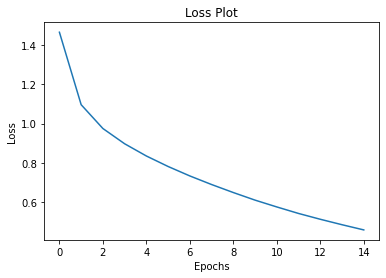

In [36]:
plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [53]:
def evaluate(image):
    attention_plot = np.zeros((max_length, attention_features_shape))

    hidden = decoder.reset_state(batch_size=1)
    temp_input = tf.expand_dims(load_image(image)[0], 0)

    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val)
    dec_input = tf.expand_dims([tokenizer.word_index['startseq']], 0)
    result = []


    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
        predicted_id = tf.argmax(predictions[0]).numpy()
        result.append(tokenizer.index_word[predicted_id])


        if tokenizer.index_word[predicted_id] == 'endseq':
            return result, attention_plot

        dec_input = tf.expand_dims([predicted_id], 0)
        

    attention_plot = attention_plot[:len(result), :]

    return result, attention_plot;

In [38]:
def plot_attention(image, result, attention_plot):
   temp_image = np.array(Image.open(image))
   fig = plt.figure(figsize=(10, 10))
   len_result = len(result)
   for l in range(len_result):
       temp_att = np.resize(attention_plot[l], (8, 8))
       ax = fig.add_subplot(len_result//2, len_result//2, l+1)
       ax.set_title(result[l])
       img = ax.imshow(temp_image)
       ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

   plt.tight_layout()
   plt.show()

In [39]:
def final_prediction(result):
    #remove "<unk>" in result
    for i in result:
        if i=="<unk>":
            result.remove(i)


    #remove endseq from result        
    result_join = ' '.join(result)
    result_final = result_join.rsplit(" ", 1)[0]
    
    return result_final

In [44]:
#### Metrics
##### Cider
#function for calculating cider metric
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

def cider(given_captions, prediction):
    prediction_arr = []
    prediction_arr.append(prediction)
    vectorizer = TfidfVectorizer()
    trainedV = vectorizer.fit(given_captions)
    givenTfIdf = trainedV.transform(given_captions).toarray()
    predTfIdf = trainedV.transform(prediction_arr).toarray()
    partialCiders = 0
    help_arr = []
    
    for c in givenTfIdf:
        help_arr.append(c)
        partialCiders = partialCiders + cosine_similarity(predTfIdf,help_arr)
        help_arr = []
        
    return partialCiders/len(givenTfIdf)

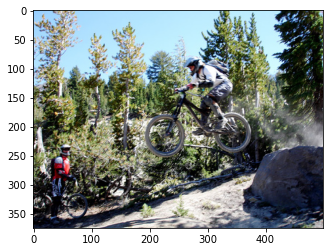


Image name: 136552115_6dc3e7231c.jpg

Valid descriptions:
['a helmeted man jumping off a rock on a mountain bike', 'a man jumping on his bmx with another bmxer watching', 'a mountain biker is jumping his bike over a rock as another cyclist stands on the trail watching', 'a person taking a jump off a rock on a dirt bike', 'the bike rider jumps off a rock']

Bahdanau attention: a person rides a dirt hill


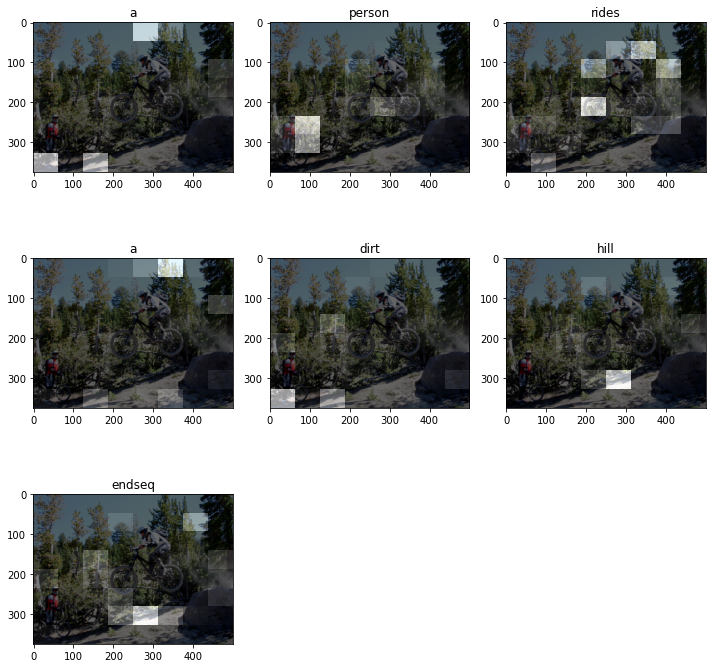

In [58]:
#### Results

pic = test_img[15]
x = np.array(Image.open(pic))
#get image name from image path
img_name = pic.split('/')[2].split('.')[0]
plt.imshow(x)
plt.show()
print("\nImage name:", img_name + ".jpg")
print("\nValid descriptions:")
print(descriptions[img_name])
    
result, attention_plot = evaluate(pic)
    
print("\nBahdanau attention:", final_prediction(result))
    
plot_attention(pic, result, attention_plot)


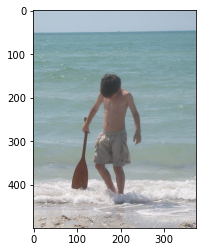


Image name: 533979933_a95b03323b.jpg

Valid descriptions:
['a boy holding an oar walk through the ocean', 'a boy is carrying a paddle whilst walking through the water on a beach', 'a boy is on the beach with a paddle in his hand as he walks through the ocean water', 'a boy with an oar walks out of the surf and onto a beach', 'a little boy walks with a paddle out into the sand']

Bahdanau attention: a young boy in a blue shirt and shorts is in the ocean


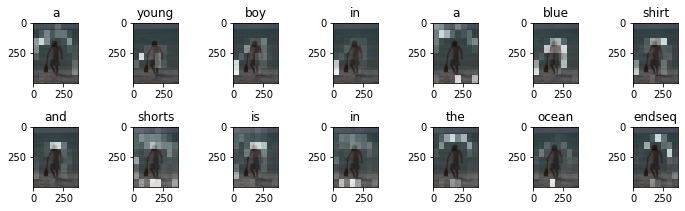


Bleu1: 0.5833333333333334

Bleu2: 1.1392803653166107e-154

Bleu3: 7.4072846580405e-204

Bleu4: 1.59216298109724e-231

Meteor: 0.18115942028985507

Cider: 0.1905112617049845

 -----------------


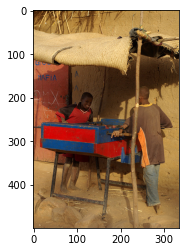


Image name: 2105756457_a100d8434e.jpg

Valid descriptions:
['two children standing under an awning', 'two kids are playing a game of foosball', 'two kids in a developing nation are playing a table top game under an awning made from burlap', 'two men play a game beneath a shade', 'two young kids are in a hut']

Bahdanau attention: a man in a vehicle that is sitting in front of a large wooden bench near a large statue of a large wooden bench near a large statue of a large wooden bench near a large


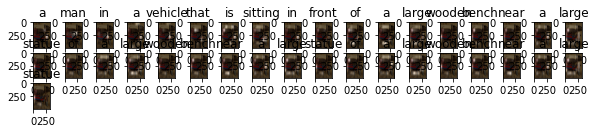


Bleu1: 0.11428571428571427

Bleu2: 0.05797710356524483

Bleu3: 4.4560790005253952e-103

Bleu4: 3.591703461242313e-155

Meteor: 0.10204081632653061

Cider: 0.14727183898383828

 -----------------


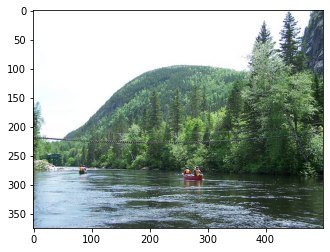


Image name: 2657484284_daa07a3a1b.jpg

Valid descriptions:
['a kayak on the river is passing by a wire bridge that joins both banks', 'some people ride their kayaks down the river', 'two conoes float down the river', 'two groups are canoeing on a river overlooking a mountain', 'two people rafting down a river a footbridge in the background']

Bahdanau attention: a group of people are standing on a lake


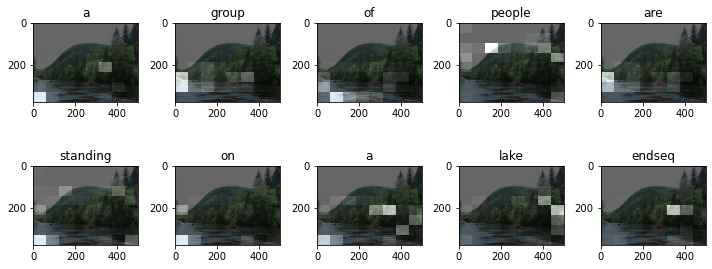


Bleu1: 0.625

Bleu2: 0.2988071523335984

Bleu3: 1.337643905120355e-102

Bleu4: 8.15394372921771e-155

Meteor: 0.25510204081632654

Cider: 0.18305080442831617

 -----------------


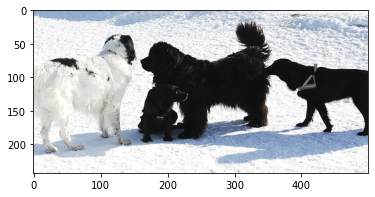


Image name: 317383917_d8bfa350b6.jpg

Valid descriptions:
['a group of dogs stand in the snow', 'four dogs stand in the snow', 'three black dogs and a white dog are standing in the snow', 'two black dogs a black puppy and a white dog in the snow', 'two large black dogs one small black dog and one large white dog are standing in some snow']

Bahdanau attention: two black and a black dog play in the snow


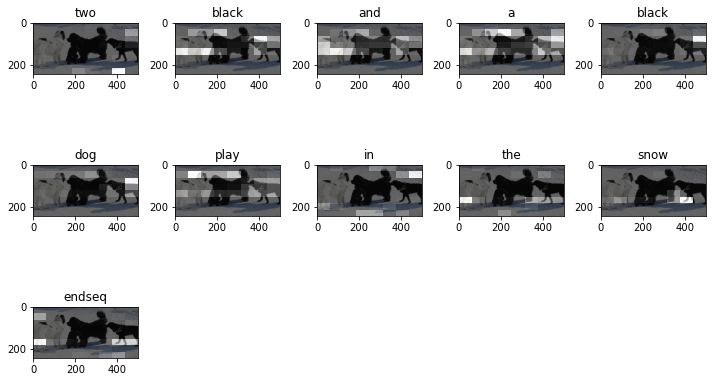


Bleu1: 0.8888888888888888

Bleu2: 0.7453559924999299

Bleu3: 2.4539867329327525e-102

Bleu4: 1.2878168092525314e-154

Meteor: 0.5574156746031746

Cider: 0.43033760365275686

 -----------------


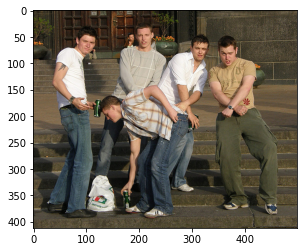


Image name: 498444334_a680d318a1.jpg

Valid descriptions:
['a group of young men clowning around while enjoying a beverage', 'five men pose awkwardly on steps', 'five young men pose on the steps', 'four boys posing while one boy sets his drink down', 'group of young men posing and holding cans']

Bahdanau attention: a group of children talk on a wall


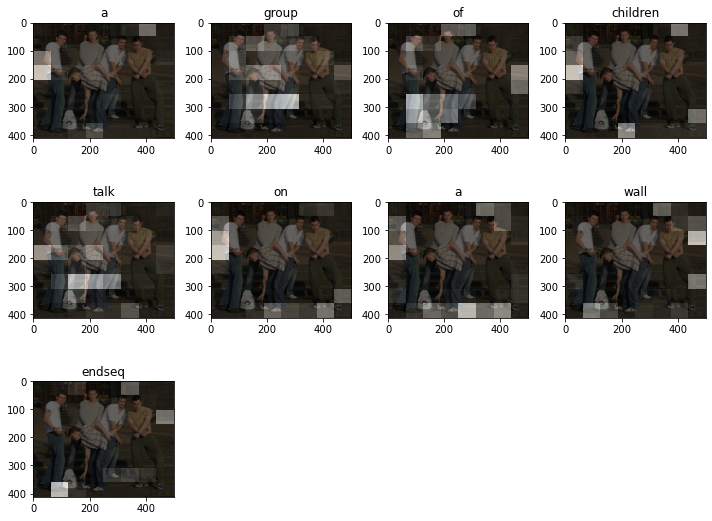


Bleu1: 0.7142857142857143

Bleu2: 0.48795003647426655

Bleu3: 0.3649272987247557

Bleu4: 5.705336763108155e-78

Meteor: 0.3537735849056604

Cider: 0.24140954883877003

 -----------------


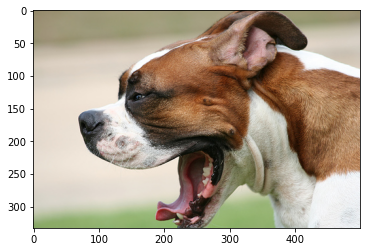


Image name: 256085101_2c2617c5d0.jpg

Valid descriptions:
['a dog with its mouth opened', 'brown and white dog yawning', 'closeup of dog in profile with mouth open', 'dog yawns', 'the dog s mouth is open like he is yawning']

Bahdanau attention: two looking in the middle of a house


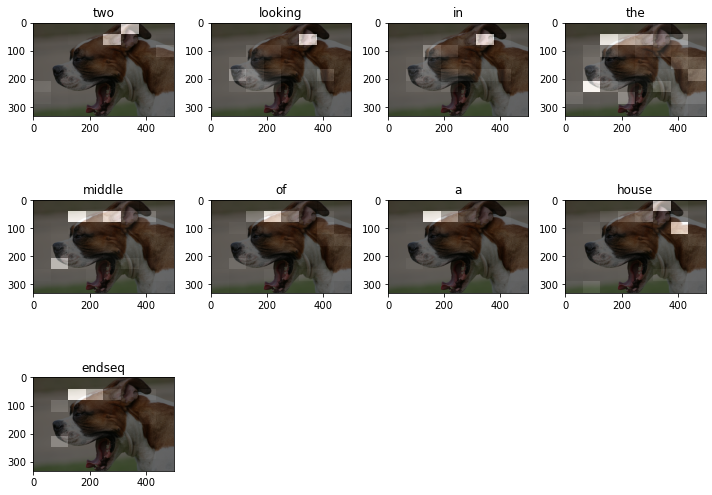


Bleu1: 0.5714285714285714

Bleu2: 1.1275951295965648e-154

Bleu3: 7.35553706361065e-204

Bleu4: 1.583976781977924e-231

Meteor: 0.12658227848101264

Cider: 0.13299737291026797

 -----------------


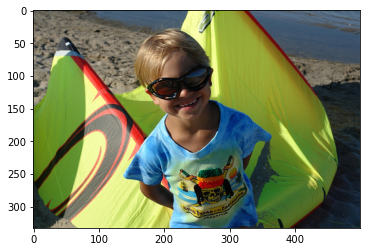


Image name: 1343426964_cde3fb54e8.jpg

Valid descriptions:
['a blond boy in a blue tee shirts stands smiling before a craft of green nylon fabric', 'a child poses wearing glasses near water outside', 'a small girl smiling on the beach', 'a young kid at the beach', 'a young man wearing swimming goggles wearing a blue shirt with a pirate skull on it']

Bahdanau attention: a young boy in a yellow shirt is sitting on a mountain


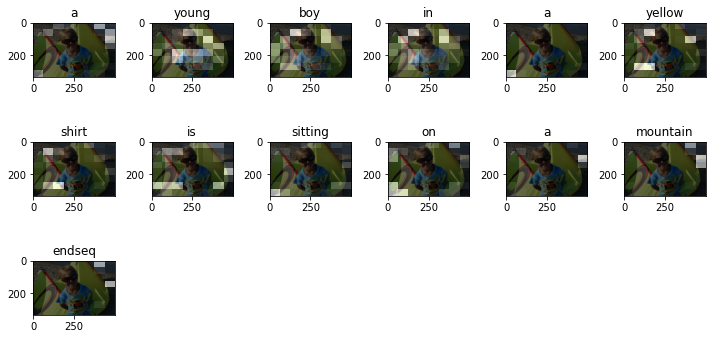


Bleu1: 0.7272727272727273

Bleu2: 0.46709936649691375

Bleu3: 0.2920969811795172

Bleu4: 4.819257363717556e-78

Meteor: 0.3116531165311653

Cider: 0.17634091103125327

 -----------------


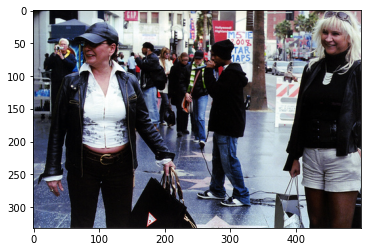


Image name: 2182488373_df73c7cc09.jpg

Valid descriptions:
['a city street with two ladies that have shopping bags in their hands with a crowd behind them', 'a woman in a hat holding a handbag smiles away from another woman wearing sunglasses and holding a shopping bag', 'people are standing on the hollywood walk of fame', 'two older women walking down the busy street with shopping bags', 'two women dressed in leather are standing on a city street']

Bahdanau attention: three people in a line in a crowd


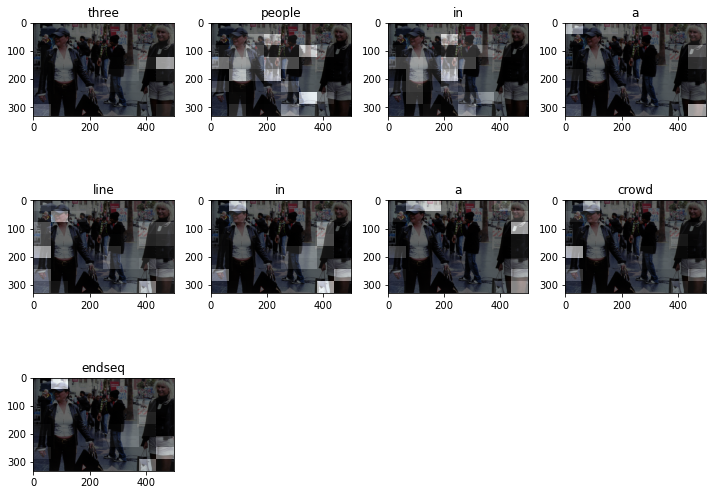


Bleu1: 0.4294155960430205

Bleu2: 0.2319109274839227

Bleu3: 1.0259275100583008e-102

Bleu4: 6.227170448085464e-155

Meteor: 0.09433962264150944

Cider: 0.13885644936401303

 -----------------


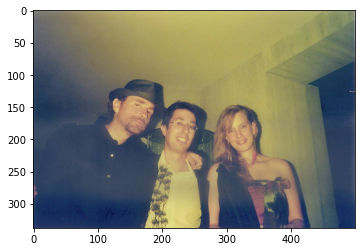


Image name: 3220126881_b0a4f7cccb.jpg

Valid descriptions:
['three people stand by a doorway posing for a photograph', 'two men and a woman pose for a picture', 'two men and a woman smile at the camera', 'two men and a woman standing near a doorway', 'two men and a woman with their arms around each other']

Bahdanau attention: a man in a black


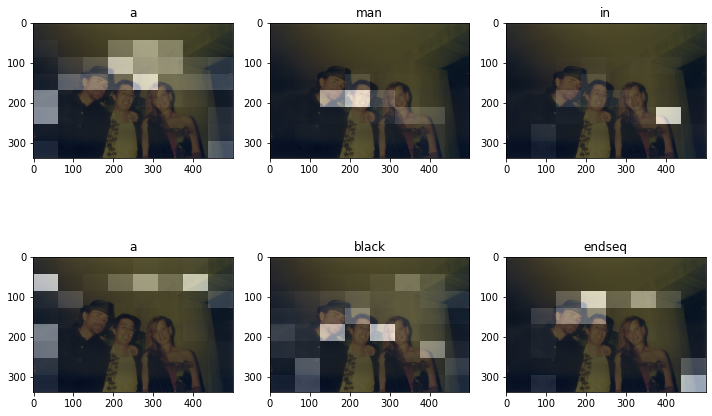


Bleu1: 0.14325239843009505

Bleu2: 3.021962810936394e-155

Bleu3: 2.0138588312094897e-204

Bleu4: 4.3891732353810896e-232

Meteor: 0.11764705882352941

Cider: 0.0

 -----------------


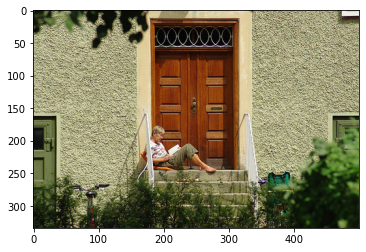


Image name: 3729525173_7f984ed776.jpg

Valid descriptions:
['a lady sitting on a front porch reading a book', 'a person sits at a doorstep and reads a book', 'a woman is reading literature and sitting on the front stoop of a building', 'a woman sits and reads in the stoop of a wooden door', 'a woman sits and reads on the front stoop of her building']

Bahdanau attention: a boy in a building


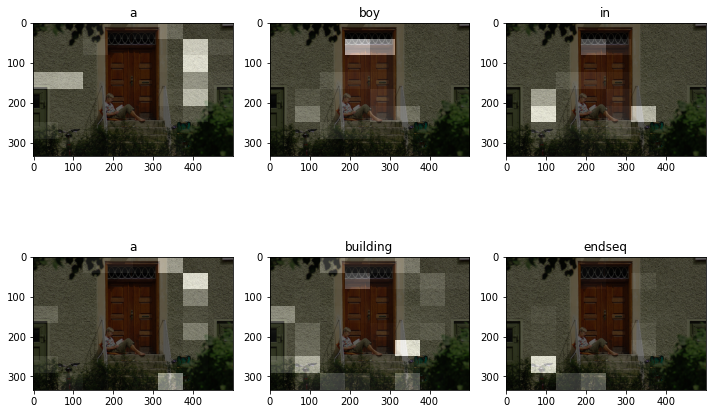


Bleu1: 0.16734762011132237

Bleu2: 2.8824456324064493e-155

Bleu3: 1.8002235197964373e-204

Bleu4: 3.782961457693801e-232

Meteor: 0.13392857142857142

Cider: 0.08159200578621546

 -----------------


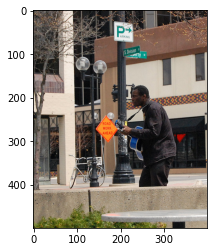


Image name: 3499720588_c32590108e.jpg

Valid descriptions:
['a dark skinned man plays a blue guitar on the street', 'a man playing his guitar on the street surrounded by buildings and street lights', 'a man plays a blue guitar on the an empty urban street', 'a man walking the streets while playing the guitar', 'the man plays his guitar on the local streets']

Bahdanau attention: a man is standing outside of a building


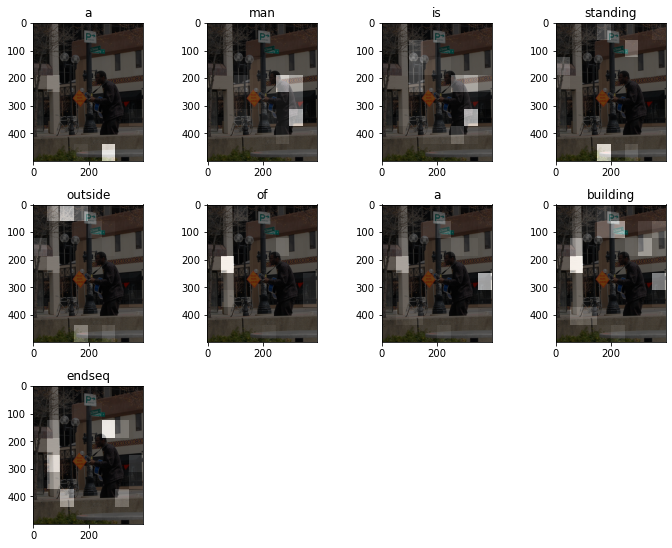


Bleu1: 0.32206169703226534

Bleu2: 0.20084075461628778

Bleu3: 9.303310268242481e-103

Bleu4: 5.795035077445241e-155

Meteor: 0.2222222222222222

Cider: 0.206168372514642

 -----------------


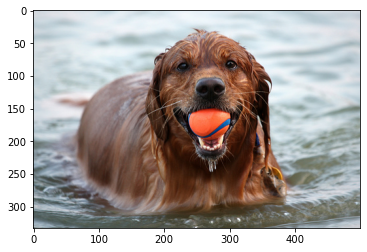


Image name: 3048597471_5697538daf.jpg

Valid descriptions:
['a brown dog is swimming through water with an orange ball in its mouth', 'a dark brow dog holds an orange ball in his mouth while walking through water', 'a dog wading in the water with a ball in his mouth', 'a wet brownishred dog with an orange ball in his mouth is swimming in some water', 'brown dog in water with orange and blue ball in mouth']

Bahdanau attention: a brown dog is sitting in the water


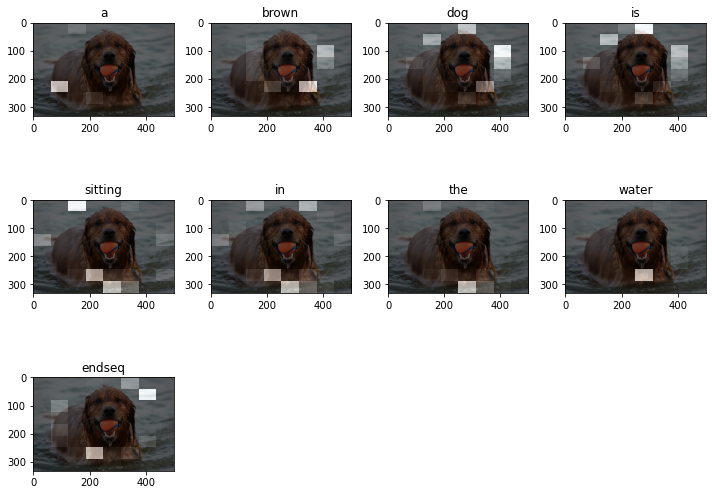


Bleu1: 0.48404410457807934

Bleu2: 0.4268867747668464

Bleu3: 0.34644914813064326

Bleu4: 0.27610369103579485

Meteor: 0.3639097744360902

Cider: 0.3306987801556153

 -----------------


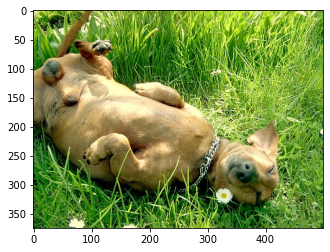


Image name: 229862312_1a0ba19dab.jpg

Valid descriptions:
['a brown puppy is laying on its back in the grass', 'a dog lays down in the long green grass', 'a dog rolling in the grass', 'a dog rolls in the grass', 'a golden dog is laying on its back in the grass']

Bahdanau attention: a large brown dog is playing in the grass


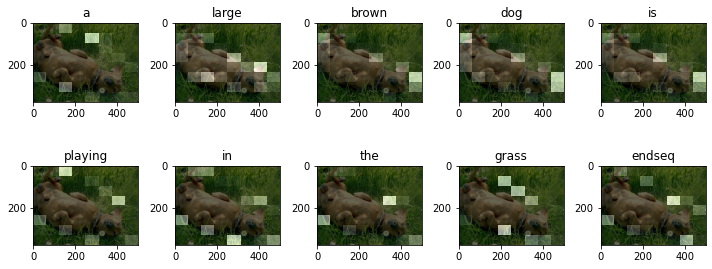


Bleu1: 0.6618726769384466

Bleu2: 0.4085166851999189

Bleu3: 1.5787567741558534e-102

Bleu4: 8.956404721575399e-155

Meteor: 0.5090725806451614

Cider: 0.3753731960150192

 -----------------


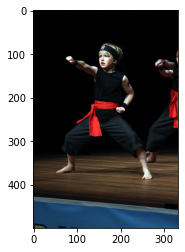


Image name: 3220161734_77f42734b9.jpg

Valid descriptions:
['a blond haired child in a black outfit and red belt doing karate', 'a child with a red sash practices martial arts', 'a girl in a black outfit with a red sash and a black headband has one hand on her waist and one extended straight out', 'a young boy wearing a black uniform with a red sash taking part in a martial arts exposition', 'a young child with a red belt does a demonstration']

Bahdanau attention: a young man in white is doing a trick on a set on a rail


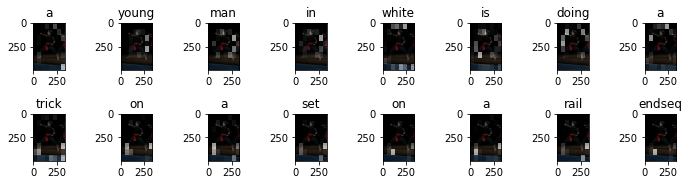


Bleu1: 0.5714285714285714

Bleu2: 0.20965696734438366

Bleu3: 1.057765552495119e-102

Bleu4: 6.830096904817037e-155

Meteor: 0.24226641414141417

Cider: 0.14037913934418939

 -----------------


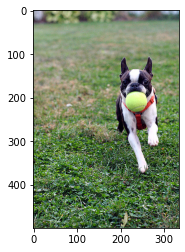


Image name: 1523984678_edd68464da.jpg

Valid descriptions:
['a dog is running with a yellow tennis ball and wearing a red harness', 'a small black and white dog running through the grass with a tennis ball in his mouth', 'small black and white dog wearing a red harness is running around with a ball in its mouth', 'small dog with red harness fetching a ball', 'the dog wearing the red collar is running across the grass with a ball in its mouth']

Bahdanau attention: a black and white dog is carrying something in its mouth


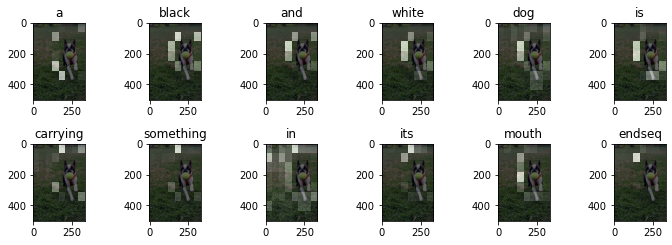


Bleu1: 0.8

Bleu2: 0.6666666666666667

Bleu3: 0.48320439053336467

Bleu4: 0.3549481056010053

Meteor: 0.436046511627907

Cider: 0.3521237346019719

 -----------------


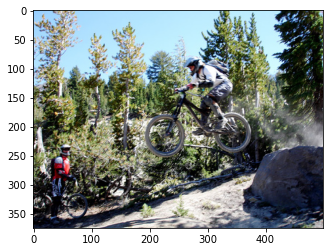


Image name: 136552115_6dc3e7231c.jpg

Valid descriptions:
['a helmeted man jumping off a rock on a mountain bike', 'a man jumping on his bmx with another bmxer watching', 'a mountain biker is jumping his bike over a rock as another cyclist stands on the trail watching', 'a person taking a jump off a rock on a dirt bike', 'the bike rider jumps off a rock']

Bahdanau attention: a person rides a dirt hill


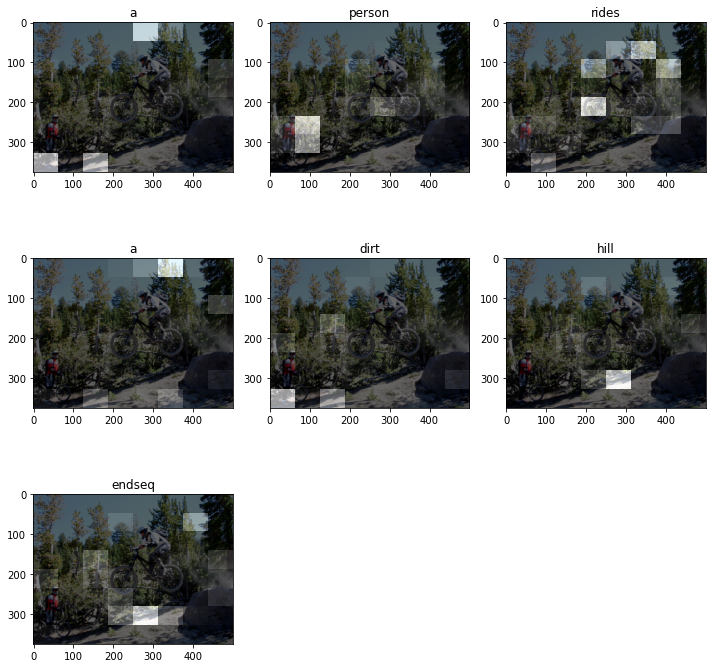


Bleu1: 0.5362560368285115

Bleu2: 0.4239476213483084

Bleu3: 1.4744042246639712e-102

Bleu4: 7.951872734206407e-155

Meteor: 0.27931415929203535

Cider: 0.12170808448059647

 -----------------


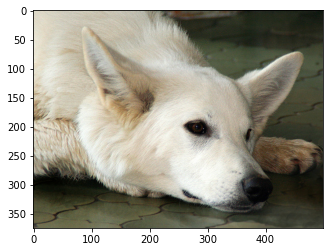


Image name: 1084040636_97d9633581.jpg

Valid descriptions:
['a closeup of a white dog that is laying its head on its paws', 'a large white dog lying on the floor', 'a white dog has its head on the ground', 'a white dog is resting its head on a tiled floor with its eyes open', 'a white dog rests its head on the patio bricks']

Bahdanau attention: a white dog is in the air


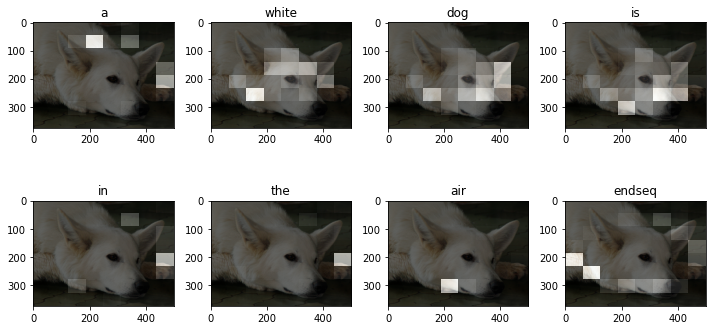


Bleu1: 0.5971094254781577

Bleu2: 0.5066641486392106

Bleu3: 0.4526510822828499

Bleu4: 0.38498150077635496

Meteor: 0.4310344827586207

Cider: 0.3390717140999598

 -----------------


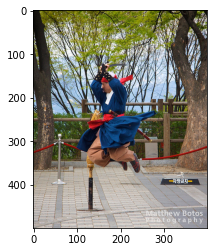


Image name: 3568197730_a071d7595b.jpg

Valid descriptions:
['a japanese swordsman jumps into the air', 'a man in a blue outfit is swinging a sword in the air', 'an actor dressed as a pirate performs in an outdoor park', 'a person wearing a blue robe is in the air holding a sword', 'man in martial artsstyle costume jumping in midair']

Bahdanau attention: a man in a blue jacket and blue pants and blue pants and blue pants and blue pants and blue pants and blue pants and blue pants and blue pants and blue pants and blue pants


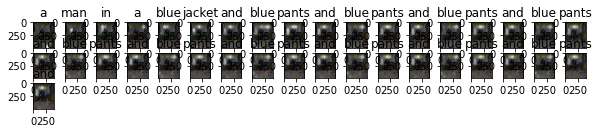


Bleu1: 0.14285714285714285

Bleu2: 0.12964074471043288

Bleu3: 0.11542472135665817

Bleu4: 0.09885362316286796

Meteor: 0.16447368421052633

Cider: 0.14832511592858372

 -----------------


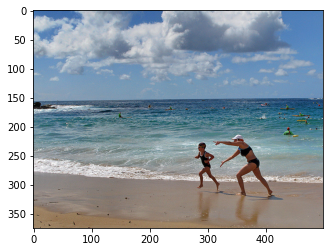


Image name: 1982852140_56425fa7a2.jpg

Valid descriptions:
['an adult and a child run on the beach', 'a woman and a little girl playing in the sand next to the ocean', 'two people run down the beach and one of them is pointing', 'two people running on a beach', 'two people running on the shore of a beach']

Bahdanau attention: a child is running away from the beach


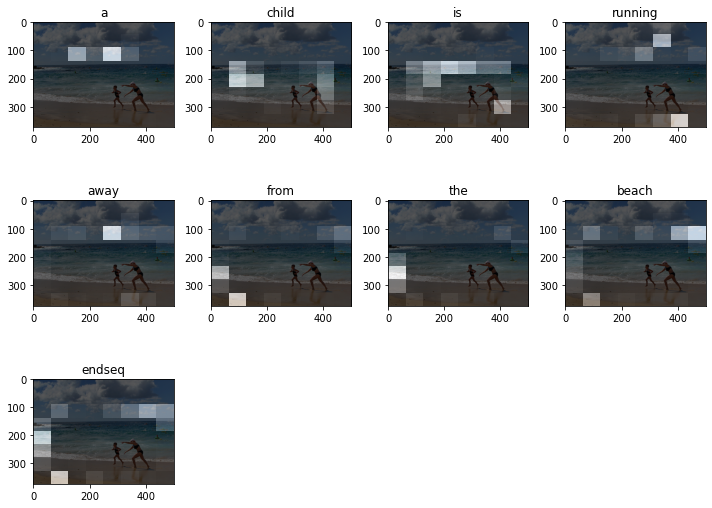


Bleu1: 0.7142857142857143

Bleu2: 0.3450327796711771

Bleu3: 1.4728218469589473e-102

Bleu4: 8.761982757198608e-155

Meteor: 0.4227272727272727

Cider: 0.24681875926378155

 -----------------


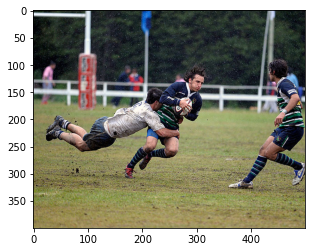


Image name: 3109704348_c6416244ce.jpg

Valid descriptions:
['during a game of rugby a man tackles another', 'men play football', 'the guys are playing a sport', 'the man with the soccor ball is being hit by another man', 'three men play ball in a field']

Bahdanau attention: two rugby players catch the player in the field


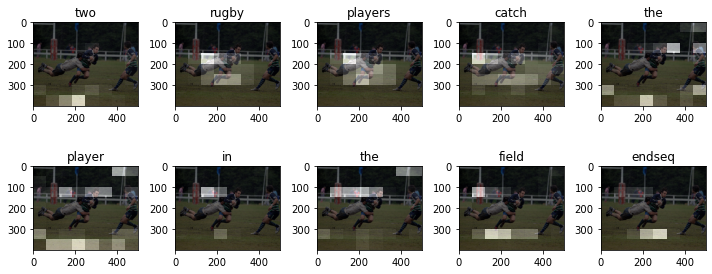


Bleu1: 0.5

Bleu2: 1.0547686614863434e-154

Bleu3: 7.029057988834377e-204

Bleu4: 1.5319719891192393e-231

Meteor: 0.08620689655172413

Cider: 0.20390441499766557

 -----------------


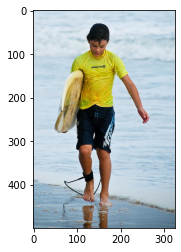


Image name: 2559921948_06af25d566.jpg

Valid descriptions:
['a boy in a yellow shirt is walking on a beach holding a surfboard', 'a boy in a yellow shirt walks with his surfboard out of the ocean', 'a little boy at the beach with a surfboard', 'a young boy in a yellow rash guard is walking on the shore carrying a surfboard', 'a young boy wearing a yellow shirt walking on the beach carrying a surfboard']

Bahdanau attention: a young boy in a tank trunks runs down a beach


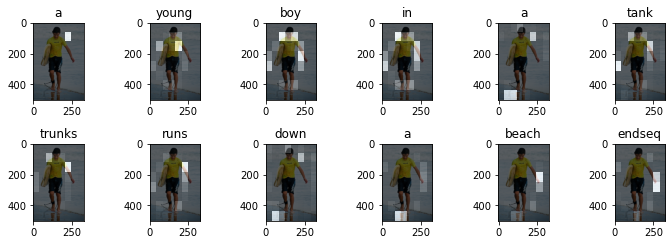


Bleu1: 0.6

Bleu2: 0.5163977794943222

Bleu3: 0.4653519225624661

Bleu4: 0.4111336169005197

Meteor: 0.38239538239538234

Cider: 0.26851427408197104

 -----------------


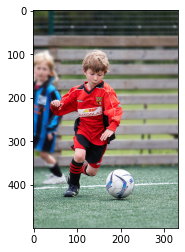


Image name: 3545652636_0746537307.jpg

Valid descriptions:
['a boy soccer player running down the field', 'a small boy wearing red runs towards a soccer ball', 'a young boy dressed in a red uniform kicks the soccer ball on the field as another child in blue watches from behind', 'a young boy wearing a red uniform lines up to kick a soccer ball', 'little boy in red getting ready to kick soccer ball while other boy watches']

Bahdanau attention: a soccer player in a black and white playing soccer


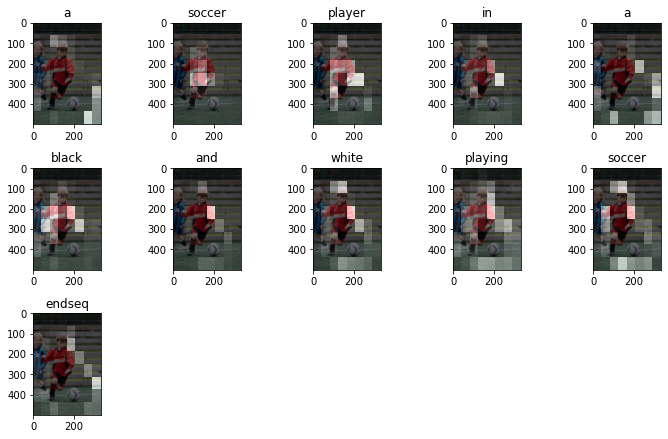


Bleu1: 0.5555555555555556

Bleu2: 0.45643546458763845

Bleu3: 1.7671008223255286e-102

Bleu4: 1.0077711150601574e-154

Meteor: 0.3155006858710563

Cider: 0.20508548002441382

 -----------------


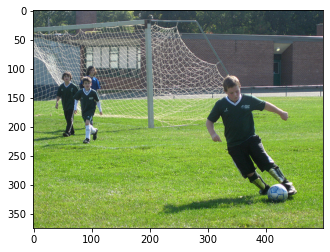


Image name: 2913965136_2d00136697.jpg

Valid descriptions:
['a boy in a green uniform is kicking a soccer ball in a game while two others stand behind him', 'boys play soccer near a goal post', 'some children are playing soccer on a sportsfield by the goal', 'the little boy gets ready to kick the soccer ball', 'three boys play soccer']

Bahdanau attention: a young boy in a black shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white


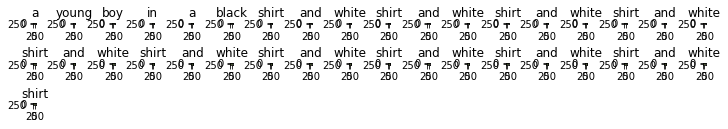


Bleu1: 0.11428571428571427

Bleu2: 0.08199200616907877

Bleu3: 0.05923242562153074

Bleu4: 1.4591279591169653e-78

Meteor: 0.14680232558139536

Cider: 0.13502142644979803

 -----------------


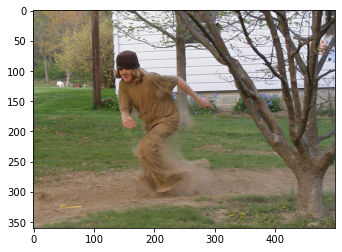


Image name: 2480850054_de3433b54a.jpg

Valid descriptions:
['a boy is kicking up dust as he runs in the dirt by a tree', 'a boy wearing brown running in dirt', 'a dirty boy runs through the dirt', 'a dusty boy runs along a dirt path through the grass', 'a teenage boy runs through the dirt near a house in the country']

Bahdanau attention: a brown dog is playing in the grass


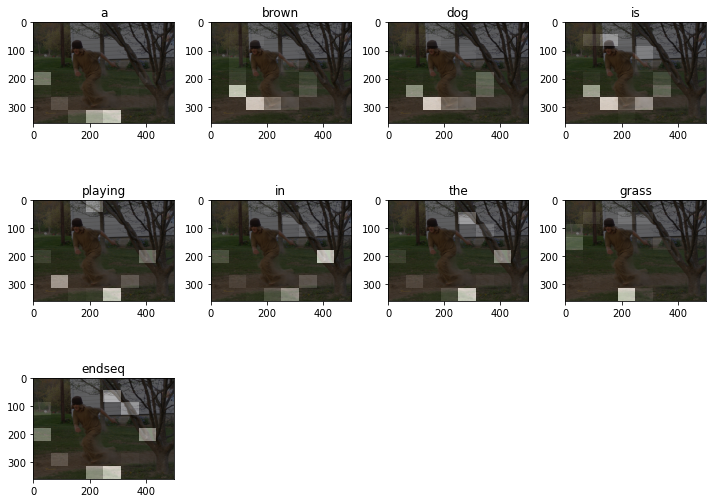


Bleu1: 0.7142857142857143

Bleu2: 0.3450327796711771

Bleu3: 1.4728218469589473e-102

Bleu4: 8.761982757198608e-155

Meteor: 0.2222711267605634

Cider: 0.24658250622140362

 -----------------


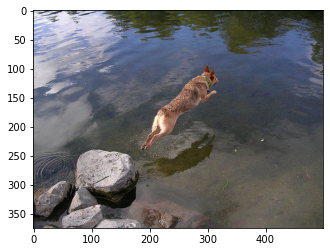


Image name: 3040033126_9f4b88261b.jpg

Valid descriptions:
['a brown dog jumping off a rock into a lake', 'a brown dog leaps into water from a rock', 'a dog is taking a dive into a body of water', 'a dog leaps over the water from a rock', 'the dog is leaping into the water']

Bahdanau attention: a dog is walking in the rocks with a stick


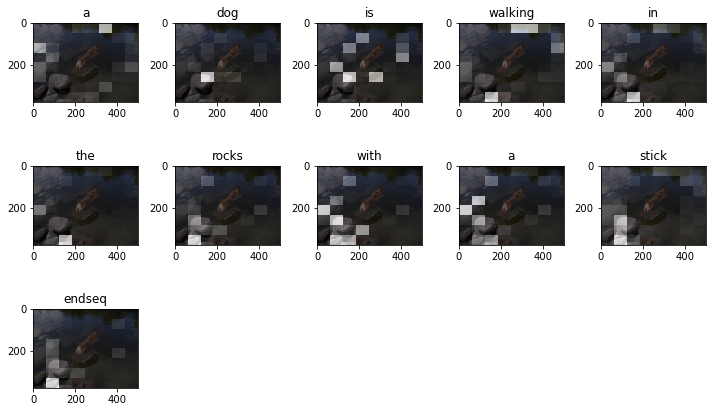


Bleu1: 0.5555555555555556

Bleu2: 0.372677996249965

Bleu3: 0.27267492221750206

Bleu4: 4.583829695130767e-78

Meteor: 0.4737654320987654

Cider: 0.3252246723798188

 -----------------


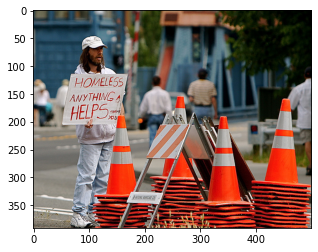


Image name: 2612488996_9450de0e54.jpg

Valid descriptions:
['a homeless man in a white cap is standing behind large orange cones', 'a homeless man standing in a construction site', 'a homeless man stands with a sign next to orange construction cones', 'a man holds a sign reading homeless anything helps near a construction site', 'stacks of orange safety cones in front of a man holding up a homeless sign']

Bahdanau attention: a baseball cap and a hat and a hat and a hat and a hat and a hat and a hat and a hat and a hat and a hat and a hat and a hat


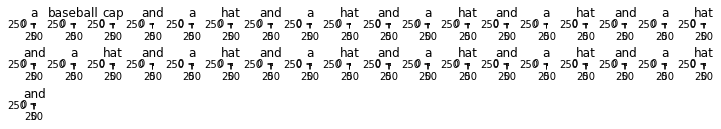


Bleu1: 0.11428571428571427

Bleu2: 5.042758721751093e-155

Bleu3: 4.255637103483989e-204

Bleu4: 1.0592691162555667e-231

Meteor: 0.09868421052631579

Cider: 0.07327151828439661

 -----------------


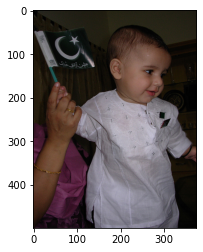


Image name: 1122944218_8eb3607403.jpg

Valid descriptions:
['a baby in a white garment holds a flag with crescent moon and star', 'a baby is holding a small black flag with a moon and a star on it', 'a baby wearing a white gown waves a muslim flag', 'a little toddler dressed in white is smiling while a lady helps him wave a flag', 'baby in white outfit holding black and white flag']

Bahdanau attention: a boy with a blue shirt with a cast up a paper in the air


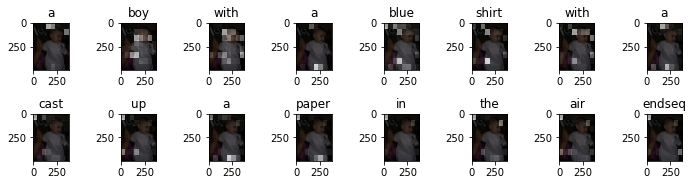


Bleu1: 0.42857142857142855

Bleu2: 0.1815682598006407

Bleu3: 9.59202383154907e-103

Bleu4: 6.356121367760845e-155

Meteor: 0.23544303797468355

Cider: 0.16904463678244752

 -----------------


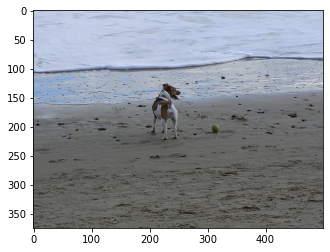


Image name: 533483374_86c5d4c13e.jpg

Valid descriptions:
['a brown and white dog is standing on a beach with a tennis ball beside it', 'a dog is on the beach near a ball', 'a dog on the beach', 'the brown dog is standing next to a ball on the beach', 'the dog stands in the sand near the ocean']

Bahdanau attention: a white dog is running on the beach


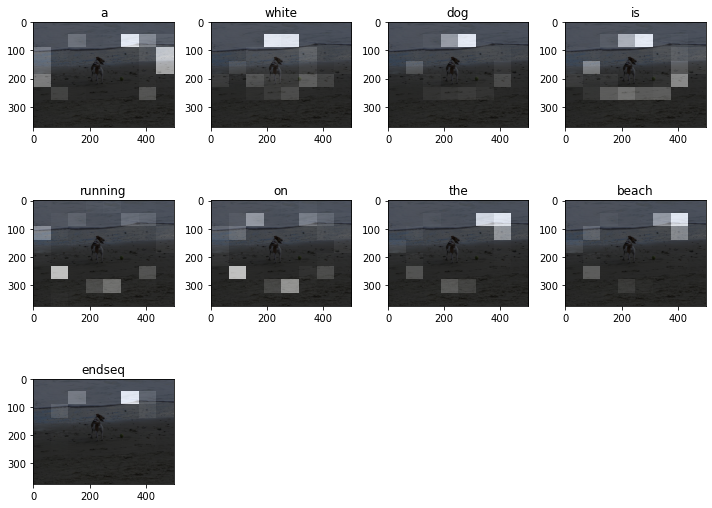


Bleu1: 0.8571428571428571

Bleu2: 0.6546536707079771

Bleu3: 0.4438519083986535

Bleu4: 6.608446987146148e-78

Meteor: 0.6069711538461539

Cider: 0.4368732499782114

 -----------------


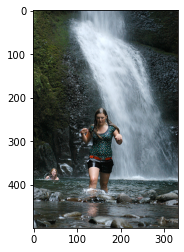


Image name: 219301555_17883a51bd.jpg

Valid descriptions:
['an extremely wet woman is wading in front of a waterfall', 'a woman dressed in shorts and a tshirt walking in shallow water in front of a waterfall', 'a woman wading through a pool in front of a waterfall', 'the lady is walking through the water', 'wet woman walking through water near a large waterfall']

Bahdanau attention: a man and little boy on wakeboard


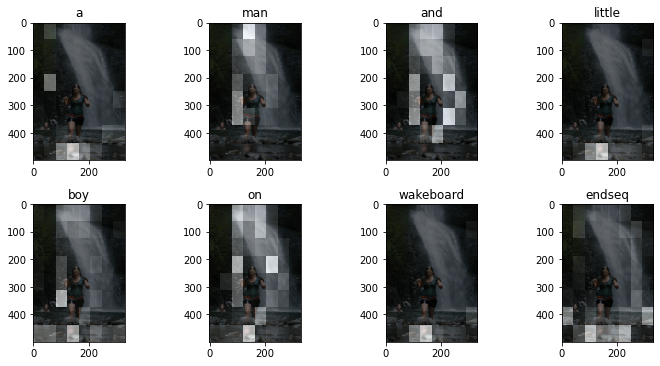


Bleu1: 0.28216057496353797

Bleu2: 7.2900276358863456e-155

Bleu3: 5.18374565653094e-204

Bleu4: 1.171778691554733e-231

Meteor: 0.06289308176100629

Cider: 0.05906550407113052

 -----------------


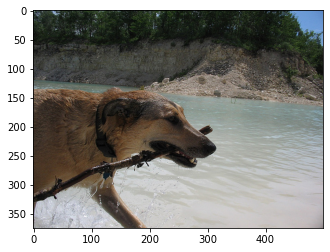


Image name: 352382023_7605223d1c.jpg

Valid descriptions:
['a dog carrying a stick while walking in water', 'a dog with a stick in his mouth walking through water', 'a large brown dog with a stick in his mouth coming out of water', 'a wet dog carrying a stick in its mouth', 'dog retrieving stick in water']

Bahdanau attention: a dog is drinking war with a stuffed animal in the water


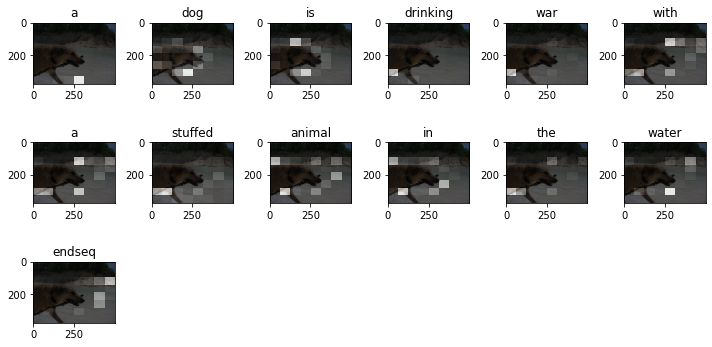


Bleu1: 0.45454545454545453

Bleu2: 0.30151134457776363

Bleu3: 1.341343007049543e-102

Bleu4: 8.190757052088229e-155

Meteor: 0.4054545454545455

Cider: 0.3288648407656398

 -----------------


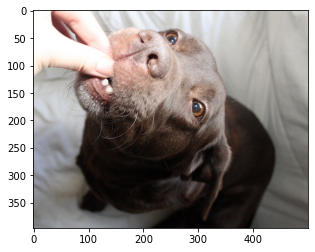


Image name: 2311690895_0d6efe11c8.jpg

Valid descriptions:
['a brown dog looks up while a person s fingers are in its mouth', 'a dog bites someone s finger', 'a dog is chewing on someone s finger', 'a person has his or her hands in a dog s mouth', 'a person touches a dog s tooth']

Bahdanau attention: a brown dog is licking his tongue out


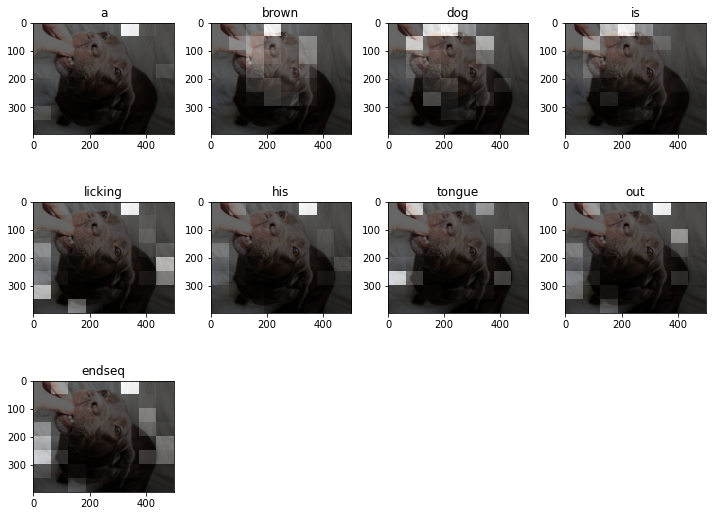


Bleu1: 0.7142857142857143

Bleu2: 0.5976143046671969

Bleu3: 0.4171732644763147

Bleu4: 6.313993041533344e-78

Meteor: 0.3234880450070324

Cider: 0.19285822217717943

 -----------------


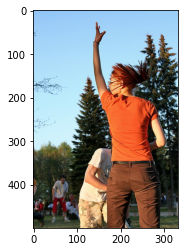


Image name: 3138399980_d6ab8b2272.jpg

Valid descriptions:
['a person in an orange shirt reaching up', 'a person wearing an orange shirt has her hand in the air as others watch', 'a woman in a park stands with her arm up in the air', 'a woman in orange throws her hand in the air', 'the woman in the orange shirt has her hand raised']

Bahdanau attention: a woman with a black shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt


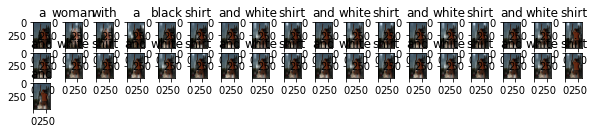


Bleu1: 0.14285714285714285

Bleu2: 0.06482037235521643

Bleu3: 4.807311744181166e-103

Bleu4: 3.797764026717455e-155

Meteor: 0.20764802631578952

Cider: 0.19809911184261972

 -----------------


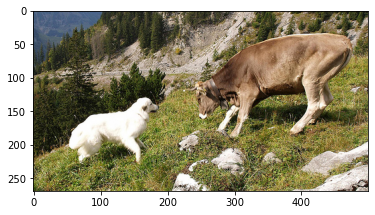


Image name: 2120411340_104eb610b1.jpg

Valid descriptions:
['a dog and a cow are on a rocky slope', 'a dog and a cow are standing on a hillside', 'a white dog looks at a nervous cow in a mountain setting', 'a white dog stands in front of a cow that has its head down and horns directed at the dog', 'two dogs are in a grassy area']

Bahdanau attention: a white dog and a white dog is climbing up a mountain


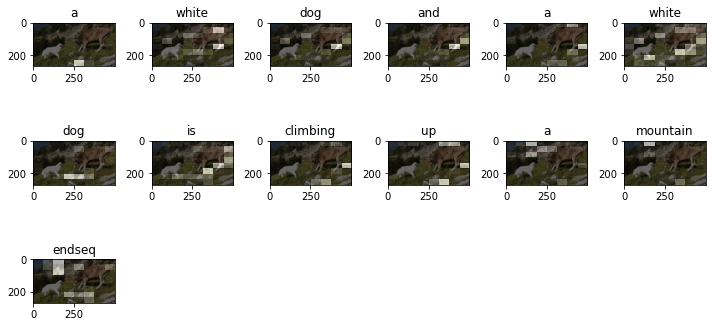


Bleu1: 0.6363636363636364

Bleu2: 0.504524979109513

Bleu3: 0.38581533739158824

Bleu4: 5.956269172906508e-78

Meteor: 0.36831683168316837

Cider: 0.2512080795904151

 -----------------


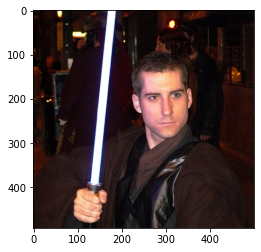


Image name: 1836335410_de8313a64e.jpg

Valid descriptions:
['a man dressed in brown holding a light saber', 'a man wearing a black outfit holding on to a glowing sword', 'man dressed up in black and brown and holding a white light saber', 'the man holds a light sabre', 'the man is playing with his star wars light sword']

Bahdanau attention: a man with a scarf on a pole


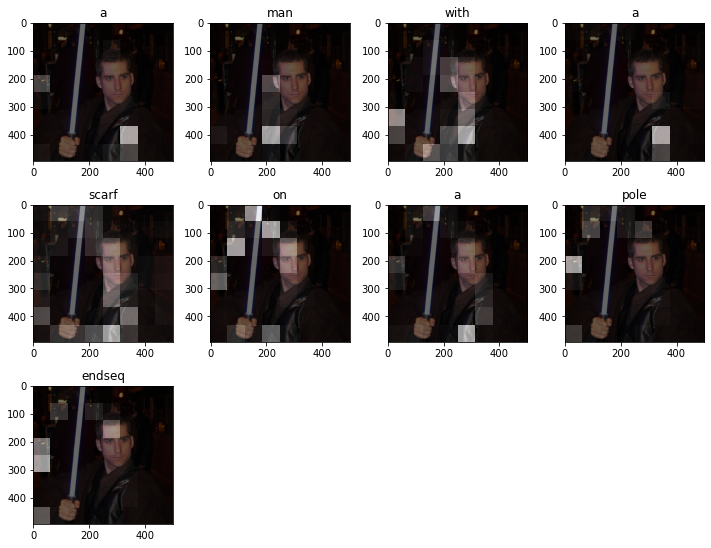


Bleu1: 0.8571428571428571

Bleu2: 0.37796447300922725

Bleu3: 1.5670102644870455e-102

Bleu4: 9.170599044431425e-155

Meteor: 0.3234782608695652

Cider: 0.16353849205542317

 -----------------


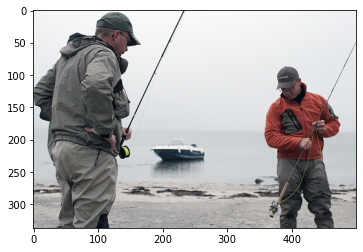


Image name: 488590040_35a3e96c89.jpg

Valid descriptions:
['men standing on shore with fishing pole and boat in water', 'two fisherman looking at the water', 'two men holding their fishing poles', 'two men stand near the water with their fishing poles', 'two men with fishing rods are standing on a shore']

Bahdanau attention: a man is walking by low poles behind


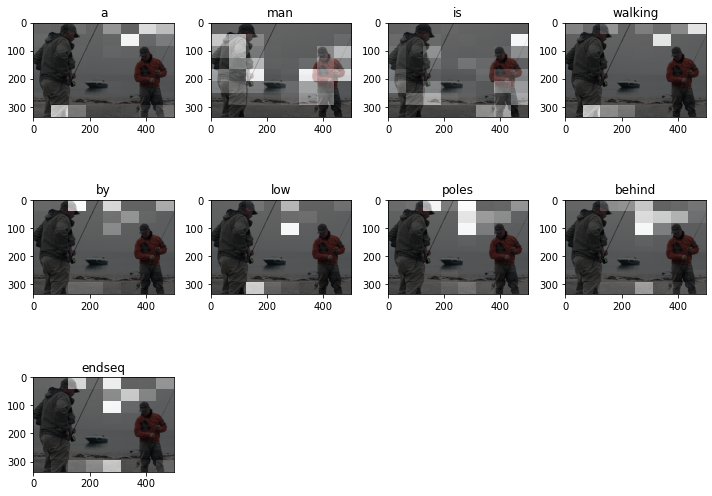


Bleu1: 0.2857142857142857

Bleu2: 7.973301625706314e-155

Bleu3: 5.811178151194588e-204

Bleu4: 1.331960397810445e-231

Meteor: 0.09433962264150944

Cider: 0.1564394210341184

 -----------------


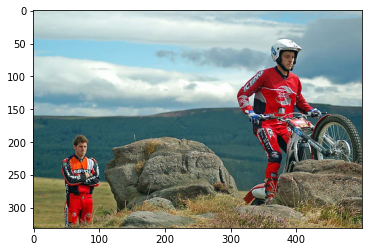


Image name: 219070971_ae43410b9e.jpg

Valid descriptions:
['a dirt biker pushes his motorcycle up a rock while another rider watches', 'a man in red on a dirt bike struggles up a rock while another man in red watches', 'a man in red pushes his motocross bike up a rock', 'a man is looking on as another man attempts to climb a small boulder with his dirt bike', 'a redclad man rides a bike through rocky ground while another man looks on']

Bahdanau attention: a woman in a blue helmet rides a daring jump


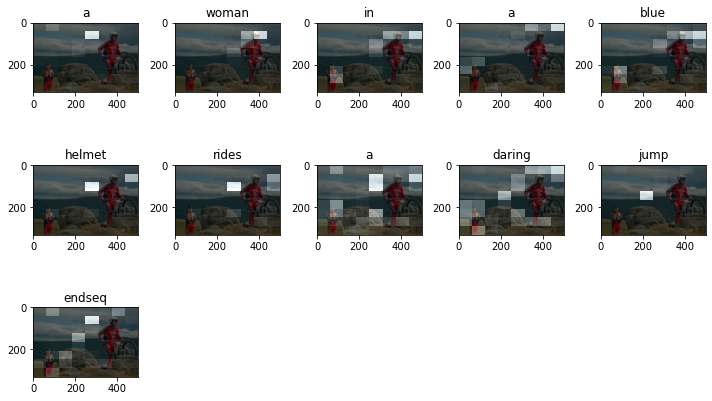


Bleu1: 0.44485411273156

Bleu2: 0.2110128334087557

Bleu3: 9.846943137979272e-103

Bleu4: 6.13157024199189e-155

Meteor: 0.18930041152263377

Cider: 0.15916864171649164

 -----------------


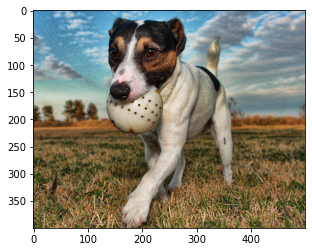


Image name: 3009644534_992e9ea2a7.jpg

Valid descriptions:
['a closeup photo of a small dog with a holey ball in his mouth', 'a dog carrying a white ball', 'a dog fetches a ball in a field', 'a dog trots with a ball in its mouth', 'the dog is carrying a whiffle ball outside']

Bahdanau attention: a white dog with brown spots is running in the air over the grass


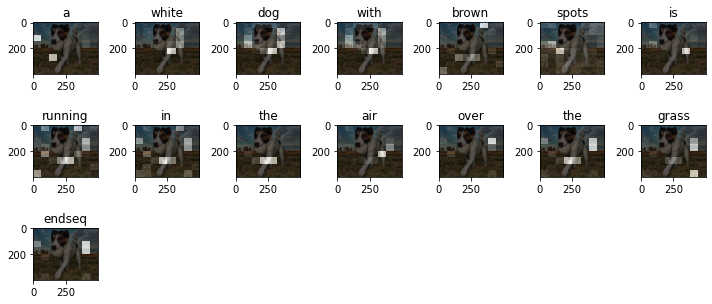


Bleu1: 0.49859442696124706

Bleu2: 0.2773923314831912

Bleu3: 1.238850999970841e-102

Bleu4: 7.559895759068455e-155

Meteor: 0.38142620232172475

Cider: 0.2793423345519386

 -----------------


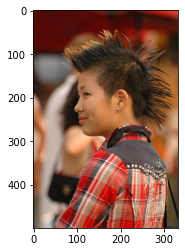


Image name: 1765164972_92dac06fa9.jpg

Valid descriptions:
['a girl with a nose ring earring and mohawk', 'a person with spiky hair looks to the left', 'a profile of a young person with a punk hairstyle and pierced ear and nose in a cowboy shirt', 'a young person with a mohawk and a nose piercing in a plaid shirt', 'the person is posing in a red flannel shirt with a mohawk']

Bahdanau attention: a young boy is standing in her hand


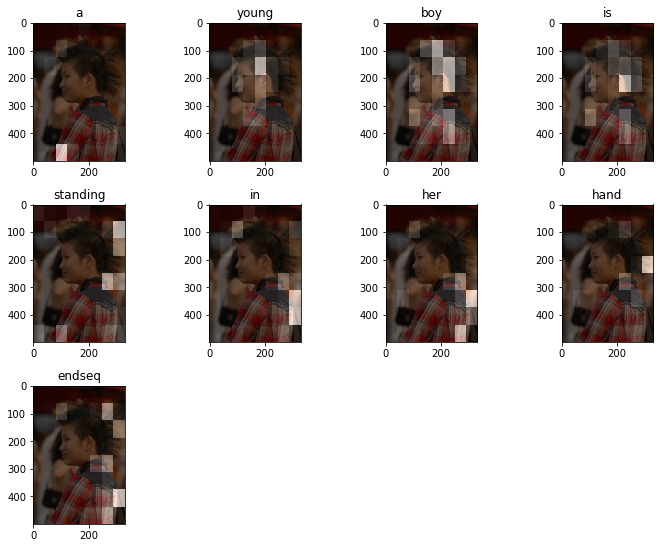


Bleu1: 0.4294155960430205

Bleu2: 0.2319109274839227

Bleu3: 1.0259275100583008e-102

Bleu4: 6.227170448085464e-155

Meteor: 0.13043478260869565

Cider: 0.18833006013572684

 -----------------


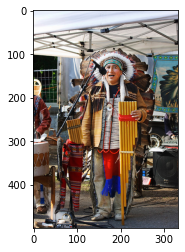


Image name: 3589367895_5d3729e3ea.jpg

Valid descriptions:
['a man dressed as an indian speaking into a microphone', 'a native american stands at a microphone ready to play his instrument', 'an indian chief in full dress', 'indian wearing headgear speaks', 'the man dressed liked an indian wearing feathers is standing in front of the microphone']

Bahdanau attention: a group of people are sitting on a street


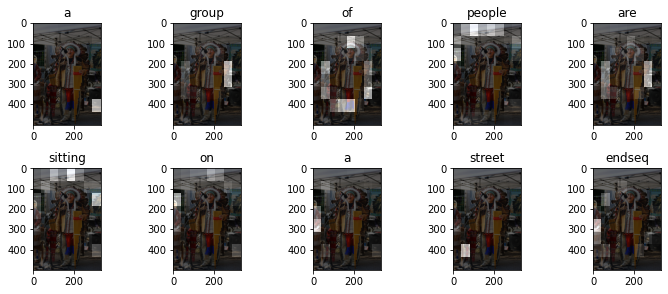


Bleu1: 0.375

Bleu2: 9.134564559628536e-155

Bleu3: 6.3740865433931635e-204

Bleu4: 1.4256605770826504e-231

Meteor: 0.10204081632653061

Cider: 0.05380293427345961

 -----------------


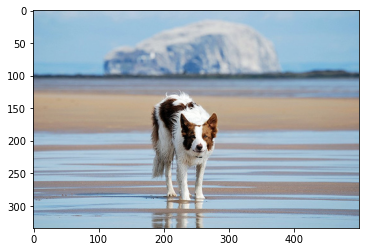


Image name: 3673165148_67f217064f.jpg

Valid descriptions:
['a brown and white dog is standing in shallow water on a beach near a large rock outcrop', 'a brown and white dog on the beach', 'a dog standing on a beach', 'a dog stands on the beach with a large rock behind him', 'an unusual looking dog is standing in front of a beautiful backdrop']

Bahdanau attention: a dog walks in the sand near the ocean


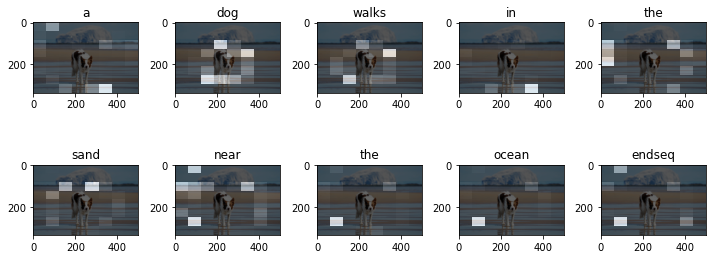


Bleu1: 0.625

Bleu2: 0.2988071523335984

Bleu3: 1.337643905120355e-102

Bleu4: 8.15394372921771e-155

Meteor: 0.1875

Cider: 0.23582529764992177

 -----------------


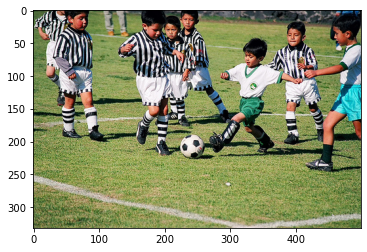


Image name: 2370481277_a3085614c9.jpg

Valid descriptions:
['a group of young boys playing soccer', 'a little boy in green is kicking a soccer ball and boys in referee shirts are following him', 'a young boy kicks a soccer ball while six others play but are dressed as referee', 'little boys play soccer on the field', 'small children kick a soccer ball on a soccer field']

Bahdanau attention: a group of boys are playing soccer one in a game


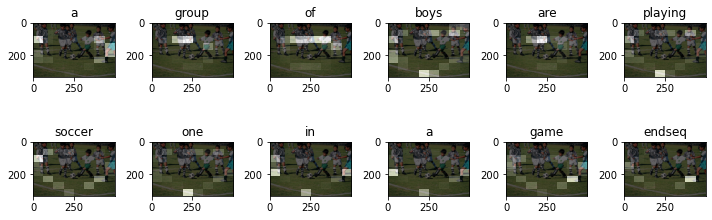


Bleu1: 0.9

Bleu2: 0.5477225575051661

Bleu3: 0.3380436197406706

Bleu4: 5.3745724892571e-78

Meteor: 0.700152207001522

Cider: 0.2961045891769306

 -----------------


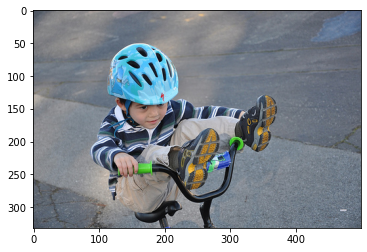


Image name: 3192069971_83c5a90b4c.jpg

Valid descriptions:
['a boy wearing a blue helmet rides a bike with his feet on the handlebars', 'a boy with a blue helmet plays on his bicycle', 'a little boy with a blue helmet rides his bike with his feet on the handlebars', 'boy in blue helmet riding bike with feet on handlebars', 'boy with a helmet resting his feet on the handlebars of his bike']

Bahdanau attention: a boy rides a toy


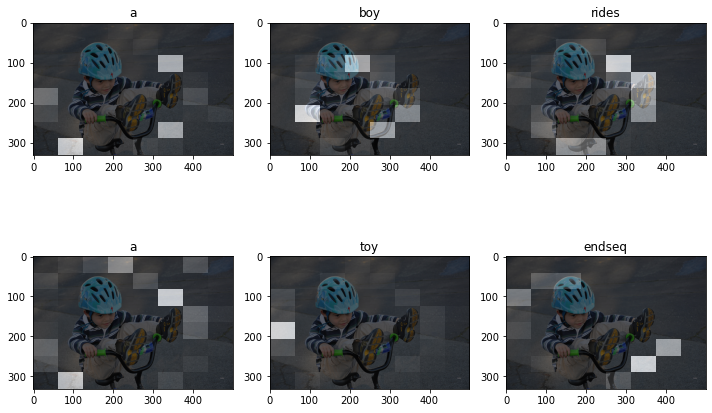


Bleu1: 0.22313016014842982

Bleu2: 0.1821850128630489

Bleu3: 5.821994944994975e-103

Bleu4: 3.0075141414524603e-155

Meteor: 0.27186761229314416

Cider: 0.23249699922739367

 -----------------


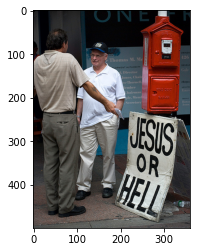


Image name: 2815256108_fc1302117d.jpg

Valid descriptions:
['two men are standing beside a sign that says jesus or hell', 'two men are standing in front of a protest sign resting on a red electric box', 'two men are talking on the street one is pointing at a sign that says jesus or hell beneath a red box and the other is standing there listening', 'two men discuss a sign that says jesus or hell', 'two men talking by a red box and a poster']

Bahdanau attention: a man in a white suit and a white bag in front of a wall


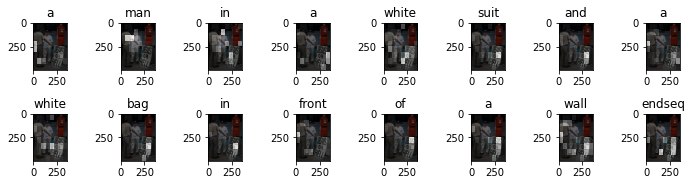


Bleu1: 0.42857142857142855

Bleu2: 0.36313651960128146

Bleu3: 0.28130436505504763

Bleu4: 0.21142141714303078

Meteor: 0.28227848101265823

Cider: 0.1361627715599394

 -----------------


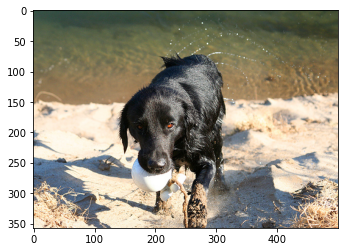


Image name: 280706862_14c30d734a.jpg

Valid descriptions:
['a black dog emerges from the water onto the sand holding a white object in its mouth', 'a black dog emerges from the water with a white ball in its mouth', 'a black dog on a beach carrying a ball in its mouth', 'a black dog walking out of the water with a white ball in his mouth', 'the black dog jumps out of the water with something in its mouth']

Bahdanau attention: a black dog carries a stick in its mouth


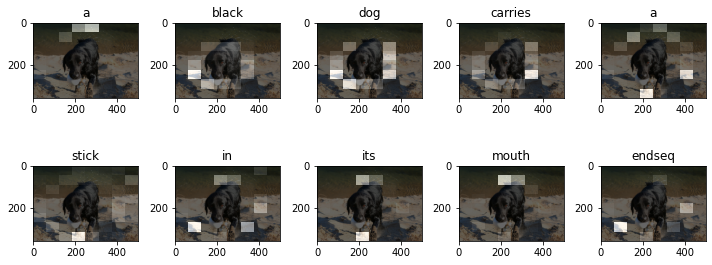


Bleu1: 0.45489799478447507

Bleu2: 0.34387056174333663

Bleu3: 0.23022439312034776

Bleu4: 3.563872626142976e-78

Meteor: 0.5471498944405349

Cider: 0.38767976514336

 -----------------


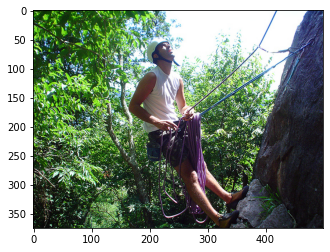


Image name: 143688283_a96ded20f1.jpg

Valid descriptions:
['a man in a harness climbing a rock wall', 'a man with a white shirt and helmet is climbing a mountain', 'a man in a white shirt and helmet is using climbing equipment', 'a young man wearing a white helmet climbing up a rock wall', 'man rock climbing looking up the rock']

Bahdanau attention: a man in a red and one in the branches


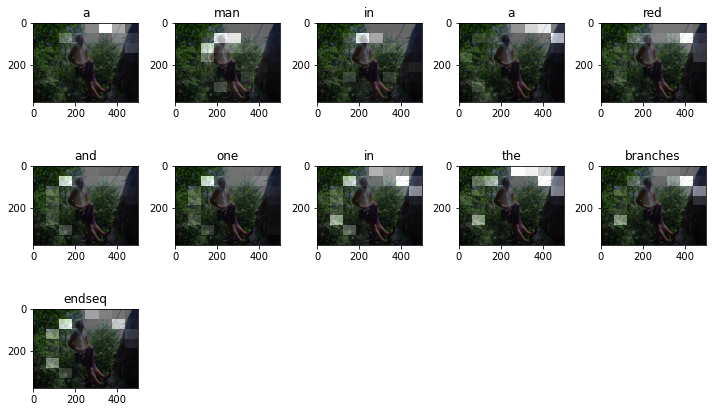


Bleu1: 0.6666666666666666

Bleu2: 0.5

Bleu3: 0.4168855439268241

Bleu4: 0.3303164318013807

Meteor: 0.31794871794871804

Cider: 0.26296681056686

 -----------------


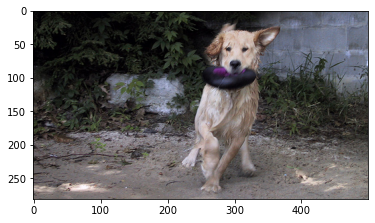


Image name: 429851331_b248ca01cd.jpg

Valid descriptions:
['a brown dog holding something purple and black in its mouth', 'a dog catches black frisbee', 'a large wet yellow dog retrives his toy', 'dog running with toy', 'the wet dog catches a toy while playing on the sand']

Bahdanau attention: a light brown dog runs on a beach


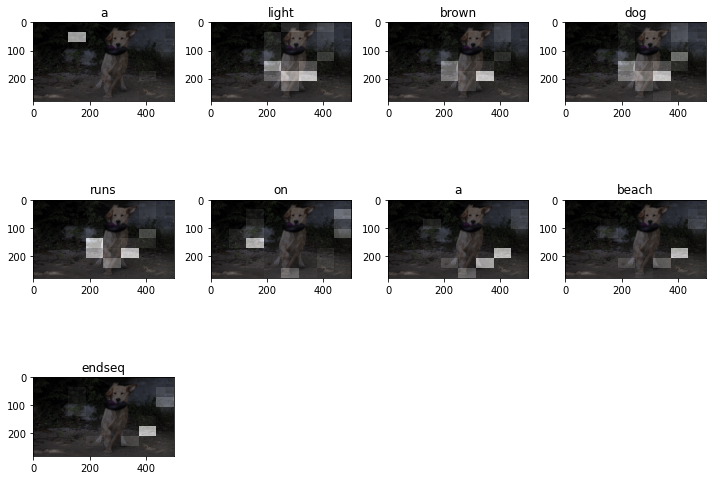


Bleu1: 0.4953587998572467

Bleu2: 0.267524327879111

Bleu3: 1.1834740629031547e-102

Bleu4: 7.183445846156676e-155

Meteor: 0.5943152454780362

Cider: 0.15817708504623712

 -----------------


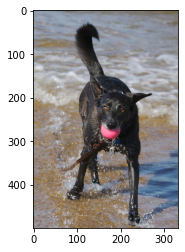


Image name: 505929313_7668f021ab.jpg

Valid descriptions:
['a black dog plays with a ball in the water', 'a black dog runs in the water holding a pink toy in its mouth', 'a black dog standing in shallow water with a pink ball in its mouth', 'a black dog stands in the surf holding a red rubber ball', 'the black dog is running though the water with a pink ball']

Bahdanau attention: a black dog is running through the water


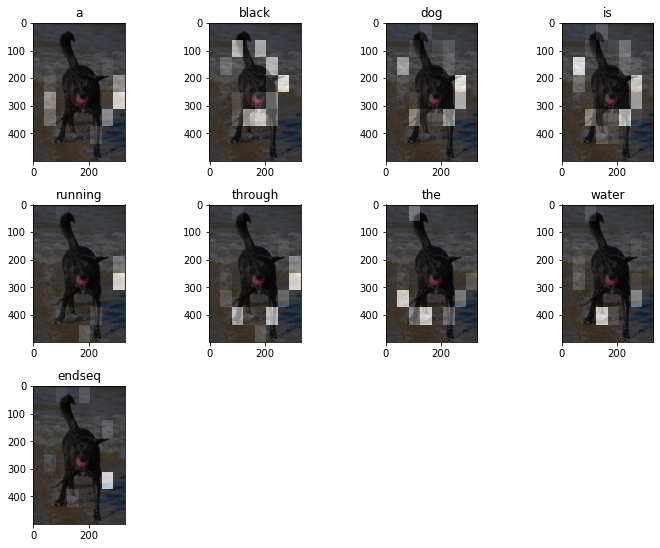


Bleu1: 0.558376335026619

Bleu2: 0.4924416401547061

Bleu3: 0.45686899087545785

Bleu4: 0.3524821233992635

Meteor: 0.4891304347826087

Cider: 0.2950226480878363

 -----------------


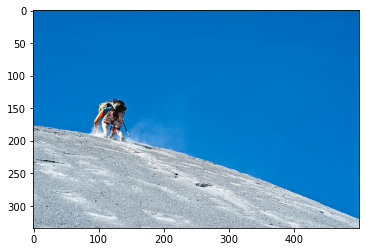


Image name: 3745451546_fc8ec70cbd.jpg

Valid descriptions:
['a hiker ascends a snowy hill', 'a man reaches the top of a tall sand dune', 'a person is hiking to the top of a hill', 'a person walks up a white sandy hill against the blue sky', 'the person is wearing shorts and climbing a gray sand hill under a blue sky']

Bahdanau attention: a person walking on a snowy mountain


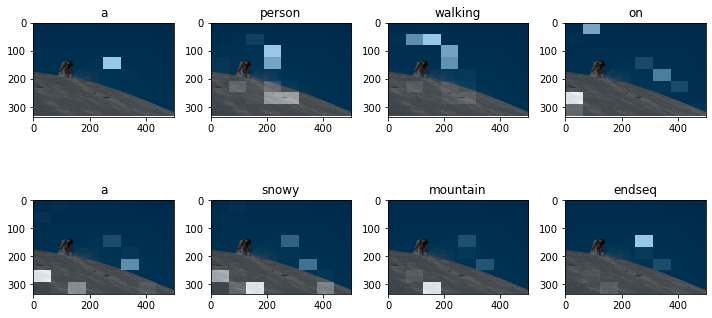


Bleu1: 0.6666666666666666

Bleu2: 0.5163977794943222

Bleu3: 1.9205801300525035e-102

Bleu4: 1.0719249972567852e-154

Meteor: 0.42592592592592593

Cider: 0.1758221427752606

 -----------------


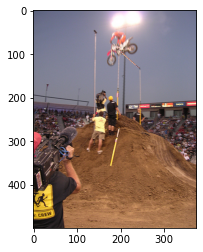


Image name: 2289068031_fe26990183.jpg

Valid descriptions:
['a motocross rider rides in the air over a bar', 'a motorbike jumping a pole', 'a person is jumping a motorcycle over a pole while camera men film', 'a professional dirt biker doing stunts while being videotaped', 'man on a motorcycle performing a trick high in the air']

Bahdanau attention: a group of people on racing


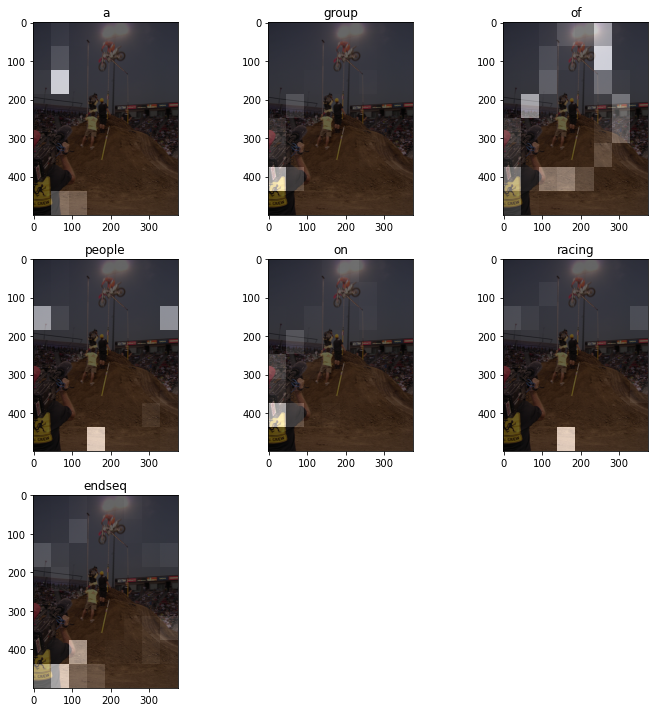


Bleu1: 0.4

Bleu2: 9.434137710479516e-155

Bleu3: 6.515499589855732e-204

Bleu4: 1.4488496539373276e-231

Meteor: 0.10000000000000002

Cider: 0.072530142009774

 -----------------


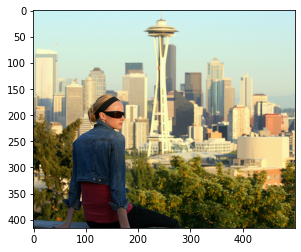


Image name: 524105255_b346f288be.jpg

Valid descriptions:
['a blonde girl poses for a picture at kerry park in seattle', 'a girl in a blue jacket is sitting in front of the seattle skyline', 'a woman looking at view of a city', 'blonde lady looks at space needle', 'blond woman overlooking seattle space needle scene']

Bahdanau attention: a man in the middle of a building


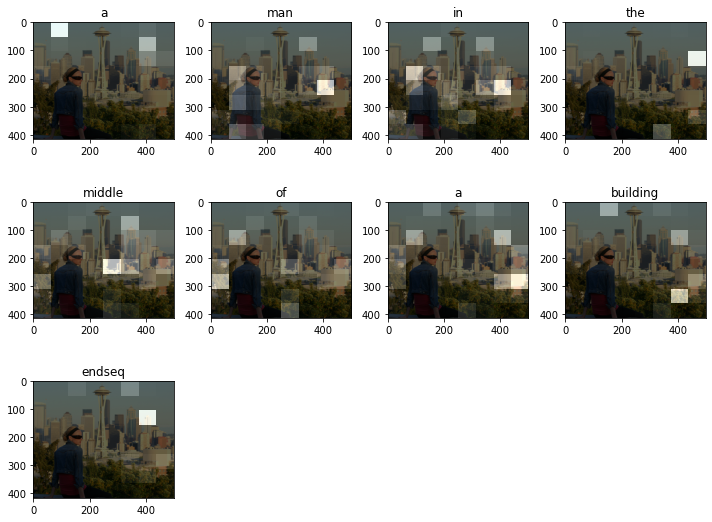


Bleu1: 0.7142857142857143

Bleu2: 0.3450327796711771

Bleu3: 1.4728218469589473e-102

Bleu4: 8.761982757198608e-155

Meteor: 0.3234880450070324

Cider: 0.18551180104235435

 -----------------


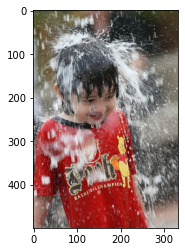


Image name: 3208074567_ac44aeb3f3.jpg

Valid descriptions:
['a boy wearing a red shirt is splashed by water', 'a child with water splashing on him', 'a little boy being splashed by water on his head', 'little kid in red pooh shirt getting wet', 'the little boy in red is getting drenched with water']

Bahdanau attention: a man in a blue shirt and splashing in water


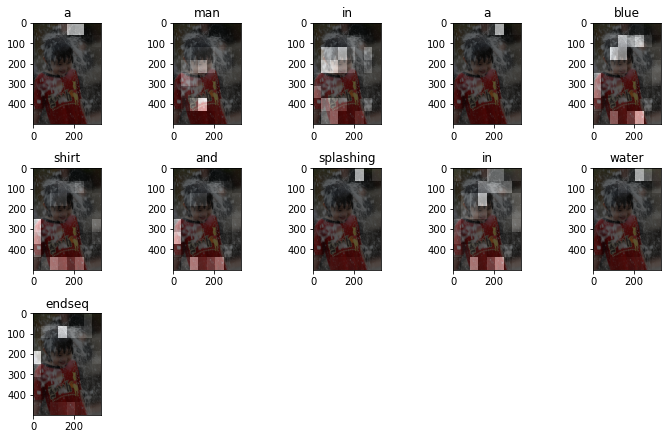


Bleu1: 0.5555555555555556

Bleu2: 1.1118237916213198e-154

Bleu3: 7.285421331249671e-204

Bleu4: 1.5728604687011317e-231

Meteor: 0.20202020202020204

Cider: 0.20257727090113958

 -----------------


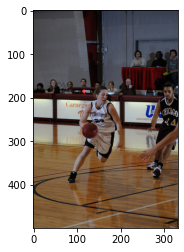


Image name: 3222055946_45f7293bb2.jpg

Valid descriptions:
['a basketball player wearing a black and white uniform dribbles the ball', 'at a women s basketball game a white skinned woman dribbles against the chicago defense', 'basketball players in action', 'the basketball player in white is dribbling the ball towards the player in black', 'woman in white dribbling basketball']

Bahdanau attention: a basketball player in blue jersey is being to make a basketball court


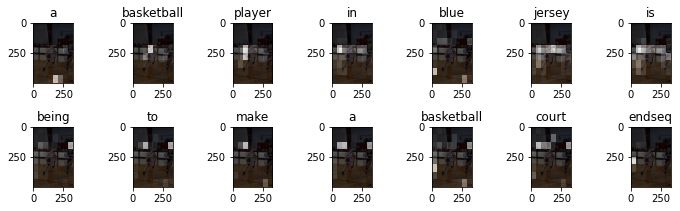


Bleu1: 0.5

Bleu2: 0.3692744729379982

Bleu3: 0.3025381368408183

Bleu4: 4.963273987908844e-78

Meteor: 0.5324074074074074

Cider: 0.31629599264387886

 -----------------


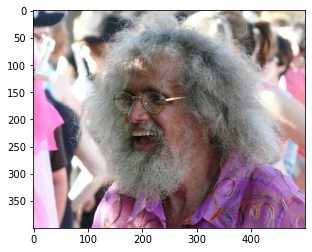


Image name: 2623930900_b9df917b82.jpg

Valid descriptions:
['a man who has a gray beard and gray hair laughs while wearing a purple shirt', 'a man with a bushy beard and pink shirt is smiling', 'a man with disheveled hair and facial hair in a crowd of people is smiling', 'a man with poofy gray hair laughing', 'an old man with white long hair and a white long beard']

Bahdanau attention: a man with a purple shirt with a camera


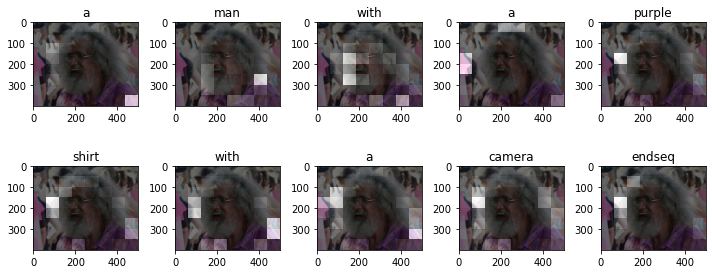


Bleu1: 0.875

Bleu2: 0.7905694150420949

Bleu3: 0.6803315125448944

Bleu4: 0.5

Meteor: 0.34766355140186916

Cider: 0.2514319637720551

 -----------------


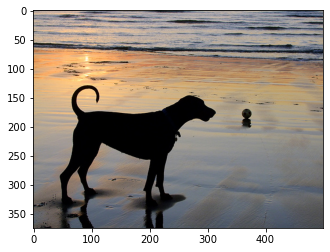


Image name: 3149919755_f9272b10b3.jpg

Valid descriptions:
['a black dog is looking at the ball on the beach by the ocean', 'a dog and a ball on a beach', 'a dog standing on a beach with a ball nearby', 'a dog stands on a beach at sunset', 'dog in shadow on beach at sunset']

Bahdanau attention: two dogs play in the snow beside the ocean


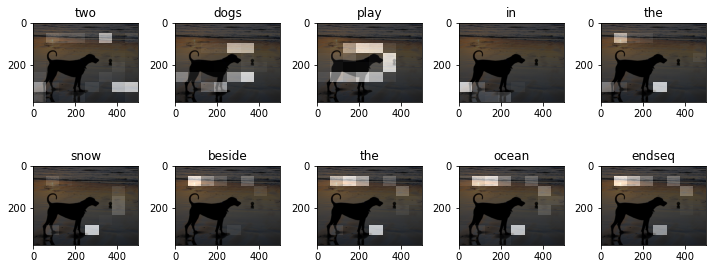


Bleu1: 0.375

Bleu2: 9.134564559628536e-155

Bleu3: 6.3740865433931635e-204

Bleu4: 1.4256605770826504e-231

Meteor: 0.2112676056338028

Cider: 0.1819689917737743

 -----------------


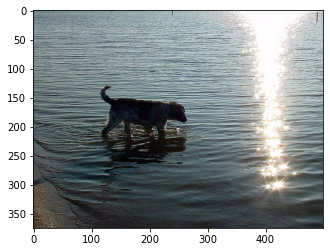


Image name: 3610683688_bbe6d725ed.jpg

Valid descriptions:
['a dog is stepping out into the water towards the sun s reflection', 'a dog is wading in the water', 'a dog wading into the water', 'a dog walking through the pound', 'the dog is walking out into the water and the sun is casting a reflection off of the water']

Bahdanau attention: a dog is walking through a lake


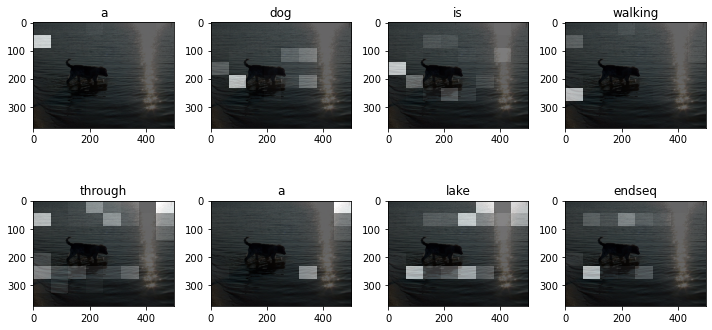


Bleu1: 0.8333333333333334

Bleu2: 0.816496580927726

Bleu3: 0.6946374176120611

Bleu4: 9.280167055464391e-78

Meteor: 0.5260416666666666

Cider: 0.31133427001649694

 -----------------


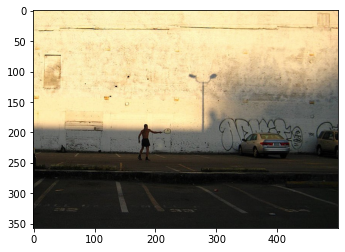


Image name: 1432179046_8e3d75cf81.jpg

Valid descriptions:
['a man in the near distance is pointing to a silver sedan near him', 'a man is playing tennis with himself against a large wall in a parking lot', 'a man walks toward a car in a parking lot', 'man stands outside against wall with tennis racket in dark', 'the man is playing tennis against the building']

Bahdanau attention: a person in a red jacket is sitting on a red drill


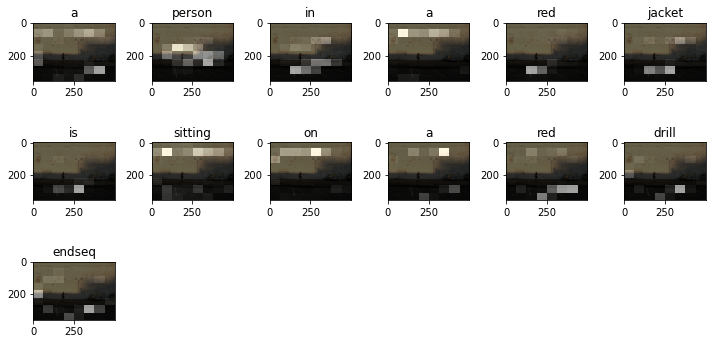


Bleu1: 0.45454545454545453

Bleu2: 0.21320071635561047

Bleu3: 1.0670872993374474e-102

Bleu4: 6.887578243315168e-155

Meteor: 0.19801980198019806

Cider: 0.22012013347776382

 -----------------


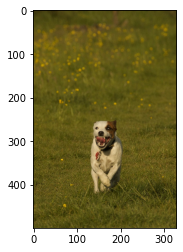


Image name: 3613800013_5a54968ab0.jpg

Valid descriptions:
['a brown and white dog is running with its mouth open accross a field', 'a brown and white dog running in a field covered in yellow flowers', 'a dog running toward the camera in a field', 'a while dog with a spot on his eye running through a meadow', 'a white dog with a brown patch over his eye runs through a grassy field covered in dandelions']

Bahdanau attention: a white dog with a blue and yellow runs through the grass


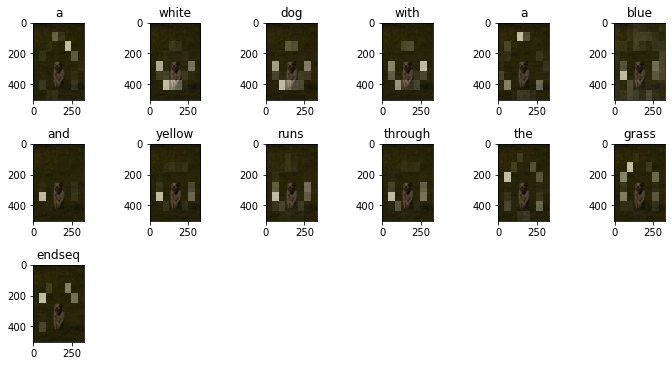


Bleu1: 0.9090909090909091

Bleu2: 0.674199862463242

Bleu3: 0.5359651782470403

Bleu4: 0.44116293593227063

Meteor: 0.4472257653061224

Cider: 0.3001866397681171

 -----------------


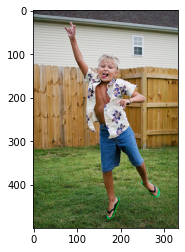


Image name: 2646046871_c3a5dbb971.jpg

Valid descriptions:
['a boy in an open hawaiian shirt is making the longhorns symbol with his hand', 'a boy wearing a flowered shirt raises his arm and jumps', 'a child in hawaiian clothing jumps and poses in a low cut yard nearby a fence and building', 'a child jumping in the air with his or her shirt flying open', 'the boy with his shirt undone is stretching his arm in the air']

Bahdanau attention: a young girl in a white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white


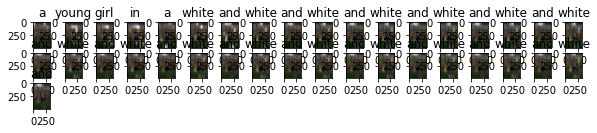


Bleu1: 0.14285714285714285

Bleu2: 0.06482037235521643

Bleu3: 4.807311744181166e-103

Bleu4: 3.797764026717455e-155

Meteor: 0.1269035532994924

Cider: 0.16051246171587036

 -----------------


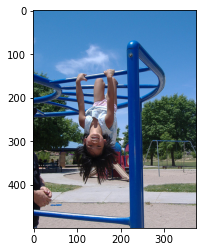


Image name: 537532165_e4b7c0e61a.jpg

Valid descriptions:
['a child playing on the monkey bars at a playground with an adult present', 'a girl hangs on the bars', 'a kid hangs upside down on the monkey bars at a playground', 'a young children hanging upside at the playground', 'girl hanging upside down on blue monkey bars']

Bahdanau attention: a young girl hanging from a blue swing set


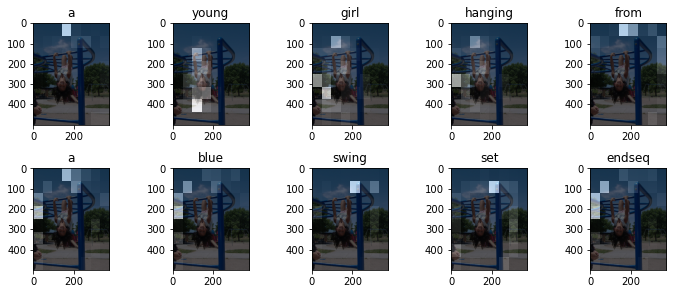


Bleu1: 0.75

Bleu2: 0.46291004988627577

Bleu3: 1.788965796403478e-102

Bleu4: 1.0148936155293581e-154

Meteor: 0.41218637992831536

Cider: 0.25484388713187334

 -----------------


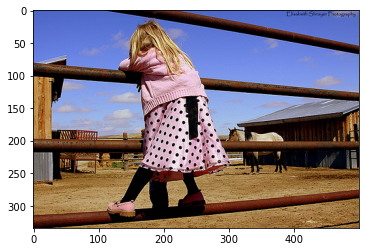


Image name: 3427233064_6af01bfc5c.jpg

Valid descriptions:
['a girl in pink polka dots looks at a horse', 'a girl is hanging on the fence watching a horse', 'a little girl stands on the fence while peeking through it to look at the horse', 'a young girl clings to a fence ant watches the horse on the other side', 'a young girl dressed all in pink is standing on a fence and looking at a horse']

Bahdanau attention: a girl playing on a chain link fence


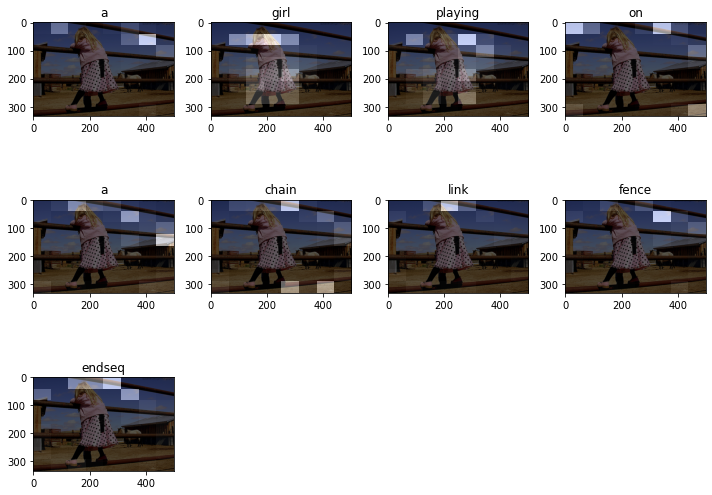


Bleu1: 0.37225089001774603

Bleu2: 0.2843113135035004

Bleu3: 1.1179297283985445e-102

Bleu4: 6.419573613943772e-155

Meteor: 0.32538659793814434

Cider: 0.24112205186959765

 -----------------


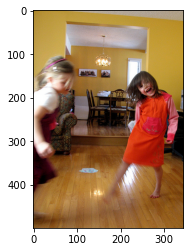


Image name: 3388330419_85d72f7cda.jpg

Valid descriptions:
['children dancing on hardwood flooring', 'two children are playing or dancing inside', 'two little girls dance on a hardwood floor in the house', 'two little girls dancing on the floor', 'two young girls playing in a house']

Bahdanau attention: a young child in a red dress on a hallway with a little girl in a hallway with a little girl in a hallway with a little girl in a hallway with a little girl in


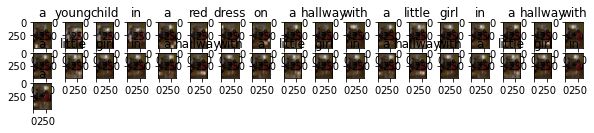


Bleu1: 0.14285714285714285

Bleu2: 0.09166984970282112

Bleu3: 6.042855157931557e-103

Bleu4: 4.5163280016739766e-155

Meteor: 0.2776119402985075

Cider: 0.2547032121850553

 -----------------


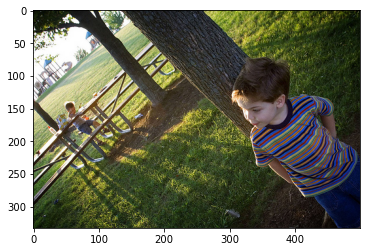


Image name: 2646116932_232573f030.jpg

Valid descriptions:
['a boy hiding behind a tree', 'a boy in a striped tshirt is standing by a tree in front of the picnic tables', 'a little boy in a striped shirt is standing behind a tree', 'a young boy in a striped shirt is leaning against a tree while another child sits at a picnic table', 'two boys in a park one standing near a tree and one sitting at a picnic table with the playground behind them']

Bahdanau attention: a child in a red shirt and jeans plants in the woods


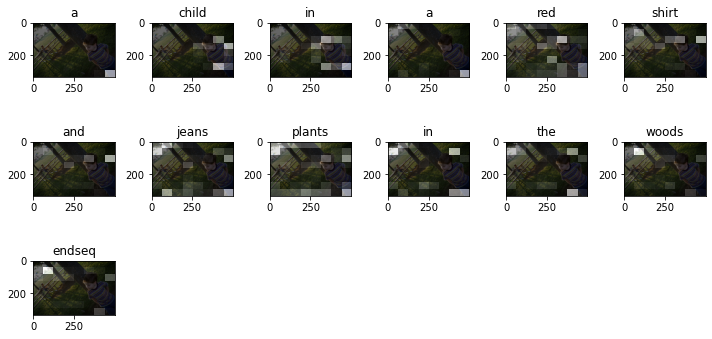


Bleu1: 0.6640732482052818

Bleu2: 0.24624495093303572

Bleu3: 1.1431926628911111e-102

Bleu4: 7.073188377392007e-155

Meteor: 0.16806722689075632

Cider: 0.23309071645712934

 -----------------


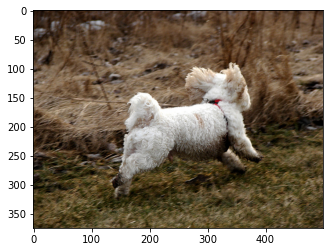


Image name: 416106657_cab2a107a5.jpg

Valid descriptions:
['a fluffy white dog runs through the woods with his ears flapping in the breeze', 'a small white dog is running across a grassy field', 'a white dog runs in the grass', 'a white dog wearing a red harness runs though the woods', 'the little white dog wearing the red collar is running in the grass']

Bahdanau attention: a white dog is running in a green grass carries a green leash in a green leash in a green leash in a green leash in a green leash in a green leash in a green


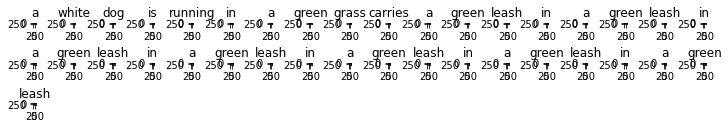


Bleu1: 0.22857142857142856

Bleu2: 0.18333969940564226

Bleu3: 0.1602912133156815

Bleu4: 0.10622513110263315

Meteor: 0.44999999999999996

Cider: 0.2708508254828816

 -----------------


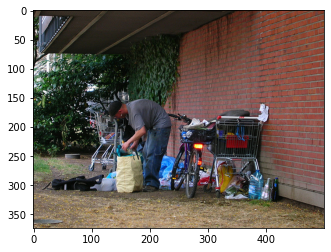


Image name: 2497420371_74788d7ba1.jpg

Valid descriptions:
['a man fiddles with a shopping bag outside near a shopping cart', 'a man gathers his belongings by the side of a building', 'a man in a black cap is opening a bag beside a bicycle and a shopping cart', 'a man looks in a bag near some grocery carts and a bike', 'a man outside at a red brick building with a grocery cart a bike and miscellaneous']

Bahdanau attention: a man in a white shirt and a child in a hole


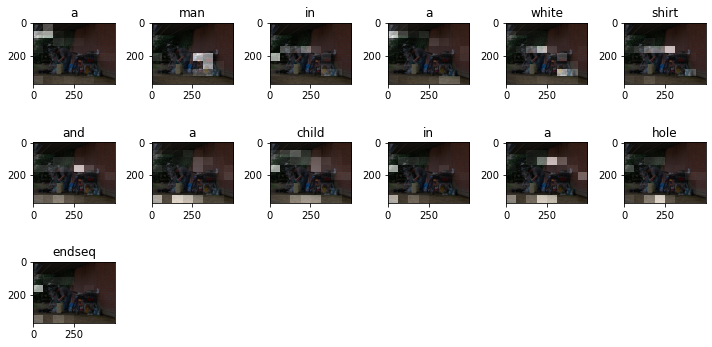


Bleu1: 0.6363636363636364

Bleu2: 0.504524979109513

Bleu3: 0.38581533739158824

Bleu4: 0.28997844147152074

Meteor: 0.275089605734767

Cider: 0.20192290326874945

 -----------------


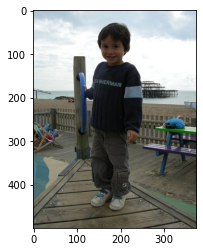


Image name: 1427391496_ea512cbe7f.jpg

Valid descriptions:
['a child in a black shirt standing on a wooden dock near a picnic table', 'a little boy is smiling for the camera on a playground', 'a young boy holds onto a blue handle on a pier', 'a young child stands on a wood dock next to the water', 'boy in green sweater with white stripe on sleeve standing on wood planked floor with body of water in the background']

Bahdanau attention: a man in the blue jacket and blue jacket and blue jacket and blue jacket and blue jacket and blue jacket and blue jacket and blue jacket and blue jacket and blue jacket and blue jacket


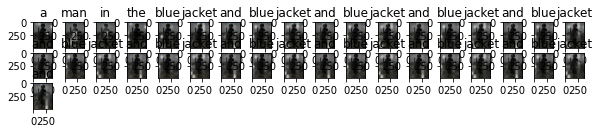


Bleu1: 0.11428571428571427

Bleu2: 0.05797710356524483

Bleu3: 4.4560790005253952e-103

Bleu4: 3.591703461242313e-155

Meteor: 0.08370535714285714

Cider: 0.0962668103880698

 -----------------


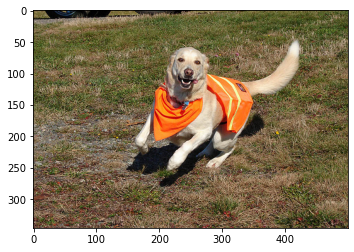


Image name: 3028969146_26929ae0e8.jpg

Valid descriptions:
['a beige dog with orange vest running on withering grass', 'a dog wearing an orange vest scampers playfully across the grass', 'a golden retriever running on short grass wearing an orange outfit', 'a lightcolored dog wearing orange plays in the grass', 'the white dog is wearing orange clothing and running through the grass']

Bahdanau attention: a white dog is jumping in the grass


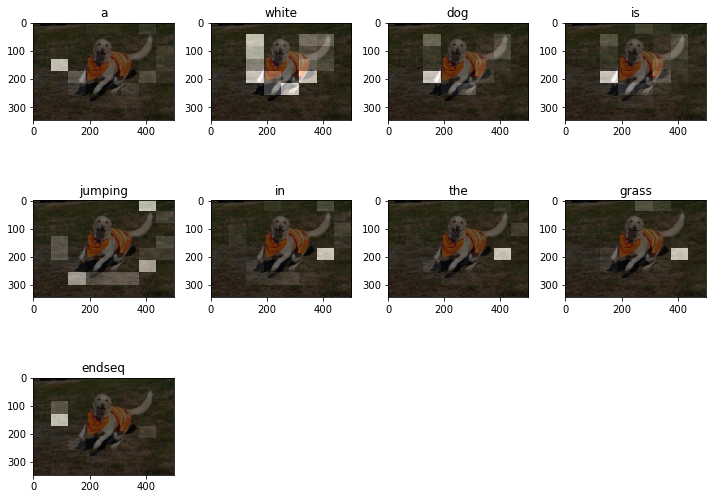


Bleu1: 0.6441233940645307

Bleu2: 0.4919573683654302

Bleu3: 0.3335446306497199

Bleu4: 4.966097853332116e-78

Meteor: 0.35866477272727276

Cider: 0.2467985944884692

 -----------------


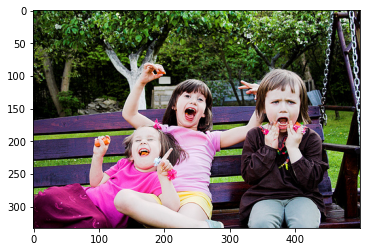


Image name: 2498897831_0bbb5d5b51.jpg

Valid descriptions:
['three children are pulling faces on a purple bench', 'three little girls are sitting on a purple bench and making funny faces', 'three little girls make silly faces on a wooden swing in an over saturated photo', 'three young girls are sitting on a bench swing in a park', 'three young girls pose together outside']

Bahdanau attention: two children sitting in the air


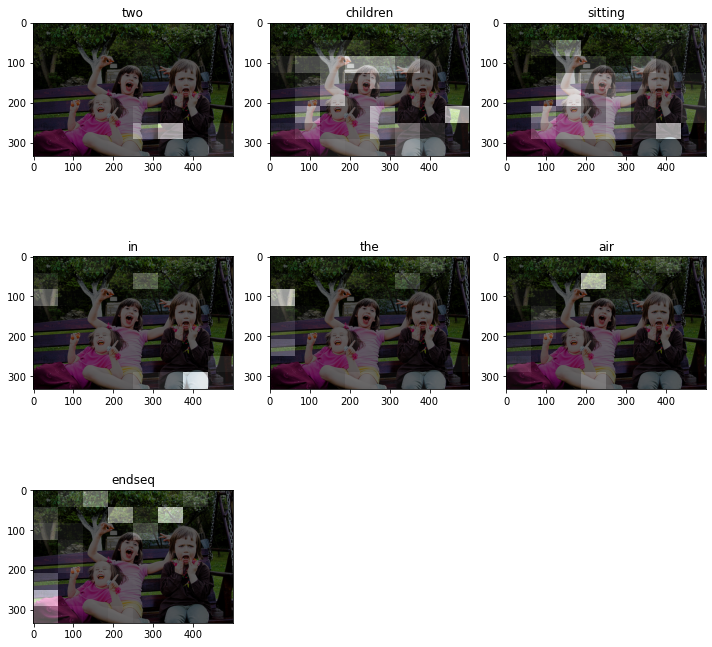


Bleu1: 0.49123845184678916

Bleu2: 9.459952255484061e-155

Bleu3: 6.122937881957981e-204

Bleu4: 1.3127657569660467e-231

Meteor: 0.08849557522123892

Cider: 0.19482032006702102

 -----------------


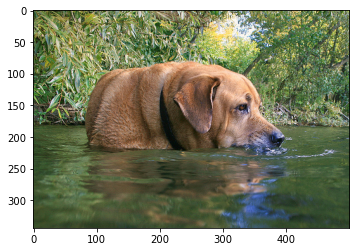


Image name: 2926233397_71e617f3a3.jpg

Valid descriptions:
['a brown dog up to its neck in water', 'a dog is almost all the way in the water and takes a drink', 'a dog possibly a basset hound stands nosedeep in pond water', 'a large dog wades through shallow water', 'the brown dog is taking a drink while wading in the water']

Bahdanau attention: a brown dog is walking in a pond


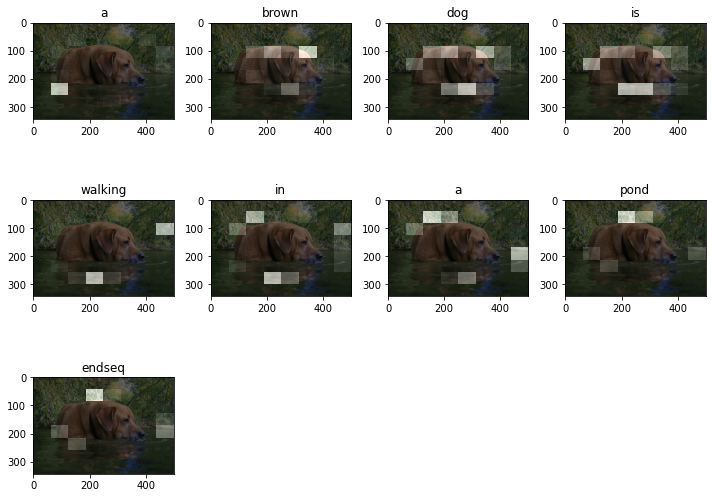


Bleu1: 0.8571428571428571

Bleu2: 0.6546536707079771

Bleu3: 0.5579277851641449

Bleu4: 7.858812176232387e-78

Meteor: 0.3878260869565217

Cider: 0.2729213986730743

 -----------------


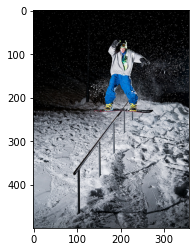


Image name: 3287549827_04dec6fb6e.jpg

Valid descriptions:
['a guy on a snowboard grinding', 'a snowboarder is attempting a trick down an outside railing', 'person in gray jacket and blue pants balancing board on handrail', 'the snowboarder is grinding on a silver rail in the nighttime snow', 'the snow borader is riding a rail']

Bahdanau attention: a man in a green jacket is jumping over a snow covered slope


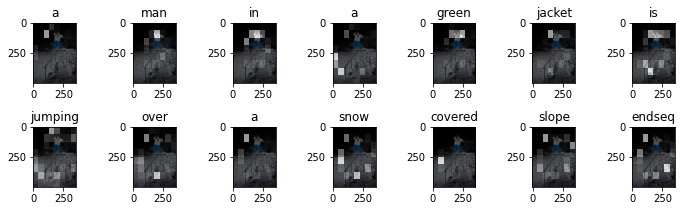


Bleu1: 0.5

Bleu2: 1.0547686614863434e-154

Bleu3: 7.029057988834377e-204

Bleu4: 1.5319719891192393e-231

Meteor: 0.19999999999999998

Cider: 0.21748748559655215

 -----------------


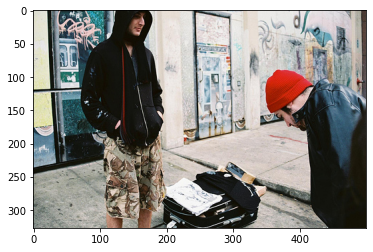


Image name: 3150742439_b8a352e1e0.jpg

Valid descriptions:
['a man in a black hoodie watching a man in a red cap', 'a man standing on a street with a suitcase in front of him while another man bends down to look at what is displayed on top of it', 'a man wearing a red hat looks down as another man watches', 'two men are standing on the street covered in graffiti', 'two people on a street one person looking down']

Bahdanau attention: a child in a black coat and black scarf in a city


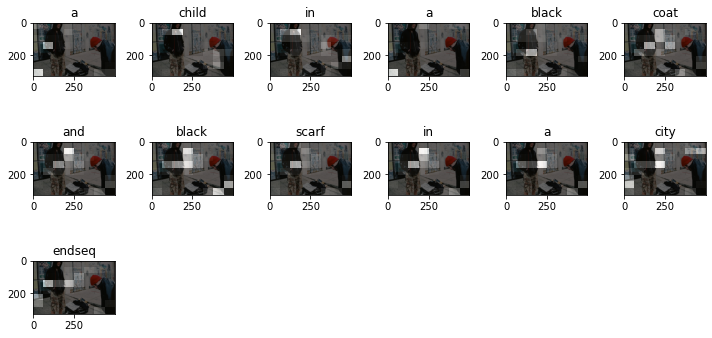


Bleu1: 0.5454545454545454

Bleu2: 0.40451991747794525

Bleu3: 0.26487922564583494

Bleu4: 4.484824319939061e-78

Meteor: 0.3331163194444444

Cider: 0.15191737342527878

 -----------------


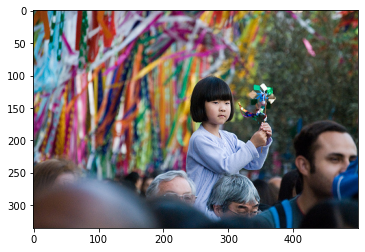


Image name: 2666205903_8d287669e1.jpg

Valid descriptions:
['a child is holding a colorful object and overlooking a crowd of people while sitting on the shoulders of an older person', 'a girl in a blue sweater sits on a person s shoulders and carries a pinwheel', 'a girls in a blue shirt holds a flower while sitting on a man s shoulders', 'a young oriential girl is standing above the crowd playing with a pinwheel', 'girl in blue sweater and holding a multicolor toy sitting on the shoulders of a man with grey hair']

Bahdanau attention: a boy is smiling


ValueError: num must be 1 <= num <= 4, not 5

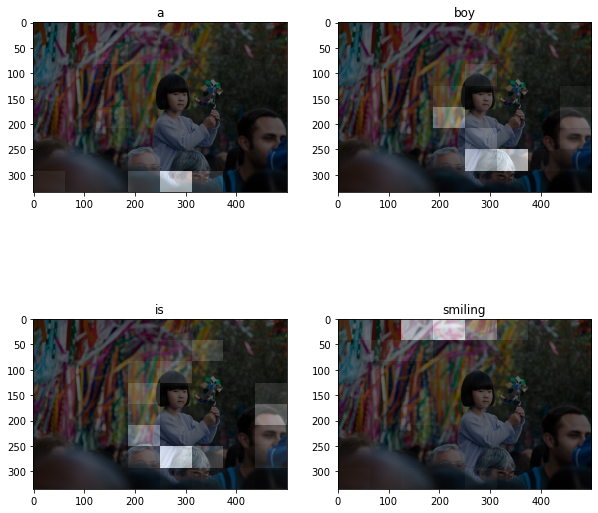

In [54]:
#### Results
for i in range(0,100):
    pic = test_img[i]
    x = np.array(Image.open(pic))
    #get image name from image path
    img_name = pic.split('/')[2].split('.')[0]
    plt.imshow(x)
    plt.show()
    print("\nImage name:", img_name + ".jpg")
    print("\nValid descriptions:")
    print(descriptions[img_name])
    
    result, attention_plot = evaluate(pic)
    
    print("\nBahdanau attention:", final_prediction(result))
    
    plot_attention(pic, result, attention_plot)
    result = result[:-1]

    split_descriptions = []
    split_descriptions.append(descriptions[img_name][0].split()) 
    split_descriptions.append(descriptions[img_name][1].split()) 
    split_descriptions.append(descriptions[img_name][2].split()) 
    split_descriptions.append(descriptions[img_name][3].split()) 
    split_descriptions.append(descriptions[img_name][4].split()) 

    print("\nBleu1:", sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(1.0,0,0,0)))
    print("\nBleu2:", sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.5, 0.5, 0, 0)))
    print("\nBleu3:", sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.34, 0.33, 0.33, 0)))
    print("\nBleu4:", sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.25, 0.25, 0.25, 0.25)))
    print("\nMeteor:", meteor_score(descriptions[img_name],final_prediction(result)))
    print("\nCider:", cider(descriptions[img_name],final_prediction(result))[0][0])
    print("\n -----------------")

In [46]:
#Calculate metrics for training set

"""
bleu_train_scores = []
meteor_train_scores = []
cider_train_scores = []
    
for i in range(0,1):
    bleu_train_scores.append([])
    meteor_train_scores.append([])
    cider_train_scores.append([])

    #calculation of metrics for train images dataset
    for j in range(0,len(train_img)):
        pic = train_img[j]
        img_code = pic.split('\\')[1].split('.')[0]

        actual_desc_0 = descriptions[img_code][0]
        actual_desc_1 = descriptions[img_code][1]
        actual_desc_2 = descriptions[img_code][2]
        actual_desc_3 = descriptions[img_code][3]
        actual_desc_4 = descriptions[img_code][4]
        
        result, attention_plot = evaluate(pic)
        bleu_train_scores[i].append(
            sentence_bleu(
                [actual_desc_0.split(), actual_desc_1.split(), actual_desc_2.split(),
                 actual_desc_3.split(), actual_desc_4.split()],
                final_prediction(result).split(), weights=(1.0,0,0,0))
        )
        meteor_train_scores[i].append(meteor_score(descriptions[img_code],final_prediction(result)))
        cider_train_scores[i].append(cider(descriptions[img_code],final_prediction(result))[0][0])

        clear_output(wait=True)
        print('train',i,j, flush=True)

result_data_tren = {}

#calculate mean score based on socres list for each metric
for i in range(0,1):
    result_data_tren[str(i)] = [
        mean(bleu_train_scores[i]),
        mean(meteor_train_scores[i]),
        mean(cider_train_scores[i]),
    ]

result = pd.DataFrame.from_dict(
    result_data_tren,
    orient='index',
    columns=['Bleu TREN','Meteor TREN','CIDEr TREN']
)

result
"""

"\nbleu_train_scores = []\nmeteor_train_scores = []\ncider_train_scores = []\n    \nfor i in range(0,1):\n    bleu_train_scores.append([])\n    meteor_train_scores.append([])\n    cider_train_scores.append([])\n\n    #calculation of metrics for train images dataset\n    for j in range(0,len(train_img)):\n        pic = train_img[j]\n        img_code = pic.split('\\')[1].split('.')[0]\n\n        actual_desc_0 = descriptions[img_code][0]\n        actual_desc_1 = descriptions[img_code][1]\n        actual_desc_2 = descriptions[img_code][2]\n        actual_desc_3 = descriptions[img_code][3]\n        actual_desc_4 = descriptions[img_code][4]\n        \n        result, attention_plot = evaluate(pic)\n        bleu_train_scores[i].append(\n            sentence_bleu(\n                [actual_desc_0.split(), actual_desc_1.split(), actual_desc_2.split(),\n                 actual_desc_3.split(), actual_desc_4.split()],\n                final_prediction(result).split(), weights=(1.0,0,0,0))\n        

In [60]:
#preparation of metrics lists
bleu1_test_scores = []
bleu2_test_scores = []
bleu3_test_scores = []
bleu4_test_scores = []
meteor_test_scores = []
cider_test_scores = []
    
for i in range(0,1):

    bleu1_test_scores.append([])
    bleu2_test_scores.append([])
    bleu3_test_scores.append([])
    bleu4_test_scores.append([])
    meteor_test_scores.append([])
    cider_test_scores.append([])

    #calculation of metrics for test images dataset
    for j in range(0,len(test_img)):
        pic = test_img[j]
        img_name = pic.split('/')[2].split('.')[0]
        split_descriptions = []
        split_descriptions.append(descriptions[img_name][0].split()) 
        split_descriptions.append(descriptions[img_name][1].split()) 
        split_descriptions.append(descriptions[img_name][2].split()) 
        split_descriptions.append(descriptions[img_name][3].split()) 
        split_descriptions.append(descriptions[img_name][4].split())

        result, attention_plot = evaluate(pic)
        
        bleu1_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(1.0,0,0,0)))
        bleu2_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.5, 0.5, 0, 0)))
        bleu3_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.34, 0.33, 0.33, 0)))
        bleu4_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.25, 0.25, 0.25, 0.25)))
        meteor_test_scores[i].append(meteor_score(descriptions[pic.split('/')[2].split('.')[0]],final_prediction(result)))
        cider_test_scores[i].append(cider(descriptions[pic.split('/')[2].split('.')[0]],final_prediction(result))[0][0])

        clear_output(wait=True)
        print('test',i,j, flush=True)


result_data_test = {}

#calculate mean score based on socres list for each metric
for i in range(0,1):
    result_data_test[str(i)] = [
        mean(bleu1_test_scores[i]),
        mean(bleu2_test_scores[i]),
        mean(bleu3_test_scores[i]),
        mean(bleu4_test_scores[i]),
        mean(meteor_test_scores[i]),
        mean(cider_test_scores[i])
    ]

result = pd.DataFrame.from_dict(
    result_data_test,
    orient='index',
    columns=['Bleu1 TEST','Bleu2 TEST','Bleu3 TEST','Bleu4 TEST','Meteor TEST', 'CIDEr TEST']
)

result

test 0 999


,Bleu1 TEST,Bleu2 TEST,Bleu3 TEST,Bleu4 TEST,Meteor TEST,CIDEr TEST
0,0.47685,0.279147,0.119775,0.038741,0.317316,0.223764


In [48]:
#preparation of metrics lists
bleu1_test_scores = []
bleu2_test_scores = []
bleu3_test_scores = []
bleu4_test_scores = []
meteor_test_scores = []
cider_test_scores = []
bad_caption_counter = 0

for i in range(0,1):

    bleu1_test_scores.append([])
    bleu2_test_scores.append([])
    bleu3_test_scores.append([])
    bleu4_test_scores.append([])
    meteor_test_scores.append([])
    cider_test_scores.append([])

    #calculation of metrics for test images dataset
    for j in range(0,len(test_img)):
        pic = test_img[j]
        img_name = pic.split('/')[2].split('.')[0]
        split_descriptions = []
        split_descriptions.append(descriptions[img_name][0].split()) 
        split_descriptions.append(descriptions[img_name][1].split()) 
        split_descriptions.append(descriptions[img_name][2].split()) 
        split_descriptions.append(descriptions[img_name][3].split()) 
        split_descriptions.append(descriptions[img_name][4].split())

        result, attention_plot = evaluate(pic)
        
        if len(result) < 20:
            bleu1_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(1.0,0,0,0)))
            bleu2_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.5, 0.5, 0, 0)))
            bleu3_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.34, 0.33, 0.33, 0)))
            bleu4_test_scores[i].append(sentence_bleu(split_descriptions,final_prediction(result).split(), weights=(0.25, 0.25, 0.25, 0.25)))
            meteor_test_scores[i].append(meteor_score(descriptions[pic.split('/')[2].split('.')[0]],final_prediction(result)))
            cider_test_scores[i].append(cider(descriptions[pic.split('/')[2].split('.')[0]],final_prediction(result))[0][0])
        else:
            bad_caption_counter += 1
        
        

        clear_output(wait=True)
        print('test',i,j, flush=True)


result_data_test = {}

#calculate mean score based on socres list for each metric
for i in range(0,1):
    result_data_test[str(i)] = [
        mean(bleu1_test_scores[i]),
        mean(bleu2_test_scores[i]),
        mean(bleu3_test_scores[i]),
        mean(bleu4_test_scores[i]),
        mean(meteor_test_scores[i]),
        mean(cider_test_scores[i])
    ]

result = pd.DataFrame.from_dict(
    result_data_test,
    orient='index',
    columns=['Bleu1 TEST','Bleu2 TEST','Bleu3 TEST','Bleu4 TEST','Meteor TEST', 'CIDEr TEST']
)
print(bad_caption_counter)

result

test 0 999
129


,Bleu1 TEST,Bleu2 TEST,Bleu3 TEST,Bleu4 TEST,Meteor TEST,CIDEr TEST
0,0.52102,0.305791,0.131703,0.04223,0.331561,0.229584
